# Find BirdNET Classification for a set of samples 

In [1]:
import os

import numpy as np
import torch
import pandas as pd
from PIL import Image
import matplotlib.pyplot as plt
from tqdm import tqdm

from bring_features_and_file_paths import bring_features_and_file_paths
from bring_features_and_file_paths import from_spectrogram_path_to_BirdNET_output_path
from bring_features_and_file_paths import get_spectrogram_time_mark_in_file
from bring_features_and_file_paths import get_BirdNET_detections

In [2]:
Spectrograms_BASE_PATH = '/grand/projects/BirdAudio/Soundscapes/Spectrograms'
BirdNET_BASE_PATH = '/grand/projects/BirdAudio/Soundscapes/BirdNET_Output'

## Analyzing the Detections in All Clusters with BirdNET

In [3]:
features, file_paths = bring_features_and_file_paths('/projects/MultiActiveAI/Samir_VICReg_Outputs/features_second_pass')

We have 2136286 feature vectors.


In [4]:
indices = torch.load('/projects/MultiActiveAI/Samir_VICReg_Outputs/indices_second_pass/include_indices.pth')
indices.shape

(1956775,)

In [5]:
label_predictions = torch.load('/projects/MultiActiveAI/Samir_VICReg_Outputs/indices_second_pass/label_predictions.pth')
label_predictions.shape

(1956775,)

In [6]:
def analyze_clusters(clusters):   
    clusters_data = {}

    for cluster in tqdm(clusters):
        cluster_indices = indices[label_predictions == cluster]

        sampled_features = features[cluster_indices]
        sampled_file_paths = file_paths[cluster_indices]

        spectrogram_duration = 9.0
        data = []
        
        for k, fpath in enumerate(sampled_file_paths):
            file_path = ''.join([chr(int(x)) for x in fpath]).replace('~','')
            BirdNET_PATH = from_spectrogram_path_to_BirdNET_output_path(fpath)
            try:
                start_time = get_spectrogram_time_mark_in_file(fpath, spectrogram_duration)

                interval = (start_time, start_time + spectrogram_duration)
                data_elements = get_BirdNET_detections(os.path.join(BirdNET_BASE_PATH, BirdNET_PATH), interval, confidence_threshold = 0.0)
                for data_element in data_elements:
                    data.append(data_element)

            except Exception:
                print(f"Error in processing spectrogram {k}/{len(sampled_file_paths)} in cluster {cluster}.")

        data = pd.DataFrame(data=data)
        
        clusters_data[cluster] = data
    return clusters_data

In [7]:
def compute_detection_rates(clusters_data, save=False):
    detection_rates = {}
    
    for data in clusters_data.values():
        total_values = data.detection.value_counts().sum()
        total_detections = total_values - data.detection.value_counts()["No detection"]
        detection_rate = total_detections / total_values

        detection_rates.append(detection_rate)

    if save:  
        torch.save(detection_rates.values(), '/projects/MultiActiveAI/Samir_VICReg_Outputs/indices_second_pass/detection_rates.pth')
    
    return detection_rates

In [18]:
clusters_data = analyze_clusters(range(100))
compute_detection_rates(clusters_data)

  1%|          | 1/100 [00:19<32:34, 19.74s/it]

Error in processing spectrogram 9516/34532 in cluster 1.
Error in processing spectrogram 9688/34532 in cluster 1.
Error in processing spectrogram 11241/34532 in cluster 1.
Error in processing spectrogram 11271/34532 in cluster 1.


  1%|          | 1/100 [00:48<1:19:38, 48.26s/it]


KeyboardInterrupt: 

In [9]:
k = 15

detection_rates = torch.load('/projects/MultiActiveAI/Samir_VICReg_Outputs/indices_second_pass/detection_rates.pth')
detection_rates = np.array(detection_rates)
top_clusters = np.argsort(detection_rates)[::-1][:k]
top_detection_rates = detection_rates[top_clusters]

print(f"Top {k} Clusters")
print("--------------")
for cluster, detection_rate in zip(top_clusters, top_detection_rates):
    print(f"Cluster {cluster} | Detection Rate: {detection_rate:.2f}")

Top 15 Clusters
--------------
Cluster 14 | Detection Rate: 0.91
Cluster 31 | Detection Rate: 0.90
Cluster 62 | Detection Rate: 0.87
Cluster 10 | Detection Rate: 0.81
Cluster 16 | Detection Rate: 0.79
Cluster 92 | Detection Rate: 0.79
Cluster 37 | Detection Rate: 0.77
Cluster 44 | Detection Rate: 0.74
Cluster 55 | Detection Rate: 0.72
Cluster 17 | Detection Rate: 0.70
Cluster 90 | Detection Rate: 0.68
Cluster 69 | Detection Rate: 0.68
Cluster 84 | Detection Rate: 0.67
Cluster 42 | Detection Rate: 0.67
Cluster 33 | Detection Rate: 0.66


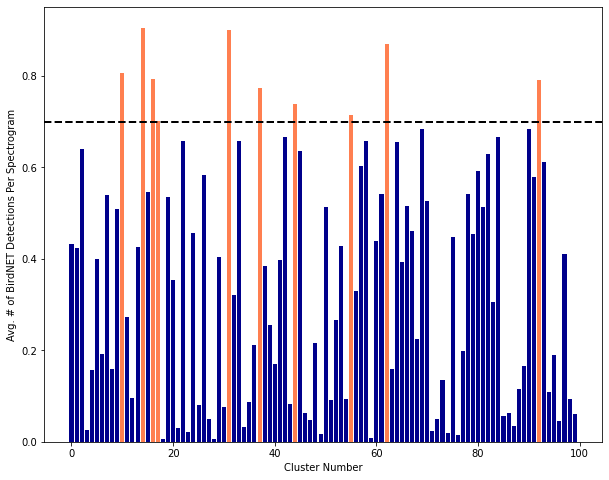

In [10]:
threshold = 0.7

fig, ax = plt.subplots(figsize=(10, 8))
ax.bar(range(100), detection_rates, color=["coral" if detection_rates[i] > threshold else "darkblue" for i in range(100)])
ax.axhline(threshold, linewidth=2, color='k', ls='--')
ax.set_xlabel("Cluster Number")
ax.set_ylabel("Avg. # of BirdNET Detections Per Spectrogram")
plt.show()

In [11]:
save_clusters = top_clusters[top_detection_rates > threshold]
save_indices = indices[[label in save_clusters for label in label_predictions]]
print(f"Saving {len(save_indices)} indices.")
# torch.save(save_indices, '/projects/MultiActiveAI/Samir_VICReg_Outputs/indices_third_pass/include_indices.pth')

Saving 212417 indices.


## Analyzing a Particular Cluster with BirdNET

In [12]:
# clusters_to_analyze = [14]
clusters_to_analyze = save_clusters

In [66]:
# cluster_indices = indices[label_predictions == cluster]

# sampled_features = features[cluster_indices]
# sampled_file_paths = file_paths[cluster_indices]

# assert sampled_features.shape[0] == sampled_file_paths.shape[0]

# print(f"There are {len(cluster_indices)} samples in the cluster.")

6050

set3/00023795/20210813_STUDY/20210813T063140-0500_Rec_843.png
Detection:  No detection
Confidence:  1.0


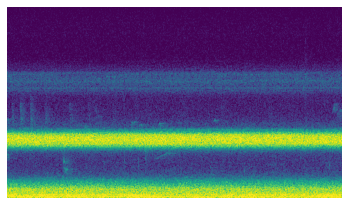

set3/00023757/20210820_STUDY/20210820T063147-0500_Rec_503.png
Detection:  Red-eyed Vireo
Confidence:  0.12198463
Detection:  Red-eyed Vireo
Confidence:  0.18847516


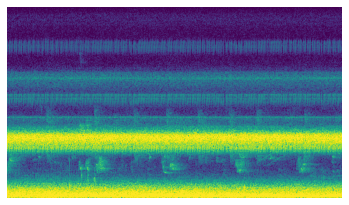

set3/00023795/20210818_STUDY/20210818T063146-0500_Rec_779.png
Detection:  Eastern Wood-Pewee
Confidence:  0.9993637
Detection:  Eastern Wood-Pewee
Confidence:  0.9525364


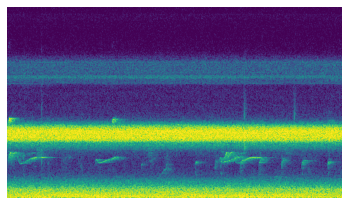

set3/00023757/20210818_STUDY/20210818T063147-0500_Rec_962.png
Detection:  Eastern Wood-Pewee
Confidence:  0.17190251
Detection:  Eastern Wood-Pewee
Confidence:  0.6323956
Detection:  Eastern Wood-Pewee
Confidence:  0.9782431


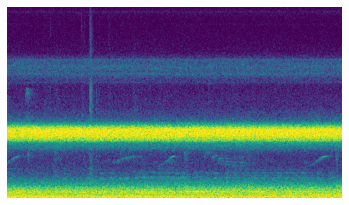

set3/00023757/20210818_STUDY/20210818T063147-0500_Rec_320.png
Detection:  No detection
Confidence:  1.0


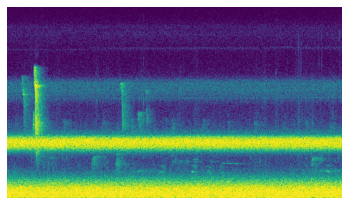

set3/00023757/20210813_STUDY/20210813T063140-0500_Rec_772.png
Detection:  Ruby-throated Hummingbird
Confidence:  0.7959658
Detection:  Eastern Wood-Pewee
Confidence:  0.4494411
Detection:  Ruby-throated Hummingbird
Confidence:  0.4330603
Detection:  Ruby-throated Hummingbird
Confidence:  0.29614192
Detection:  Eastern Wood-Pewee
Confidence:  0.2650625


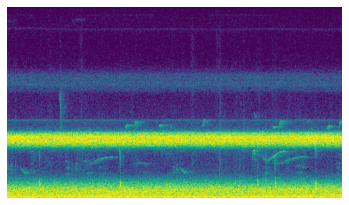

set3/00023757/20210819_STUDY/20210819T030852-0500_Rec_1328.png
Detection:  Ovenbird
Confidence:  0.10214636


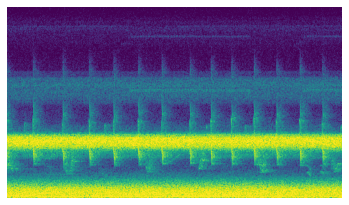

set3/00023757/20210820_STUDY/20210820T030852-0500_Rec_1004.png
Detection:  No detection
Confidence:  1.0


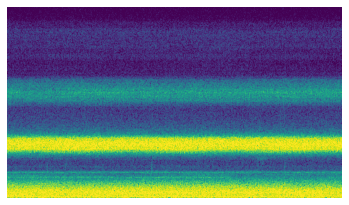

set3/00023757/20210817_STUDY/20210817T063147-0500_Rec_1056.png
Detection:  Red-headed Woodpecker
Confidence:  0.10780322


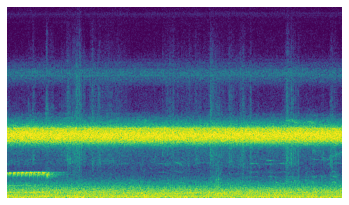

set3/00023757/20210813_STUDY/20210813T063140-0500_Rec_1001.png
Detection:  Blue Jay
Confidence:  0.9888127
Detection:  Blue Jay
Confidence:  0.44745725
Detection:  Eastern Wood-Pewee
Confidence:  0.18139961
Detection:  Blue Jay
Confidence:  0.84819716


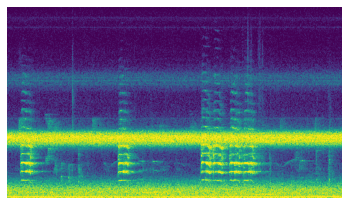

set3/00023795/20210818_STUDY/20210818T063146-0500_Rec_740.png
Detection:  Eastern Wood-Pewee
Confidence:  0.6957147
Detection:  Eastern Wood-Pewee
Confidence:  0.9894454


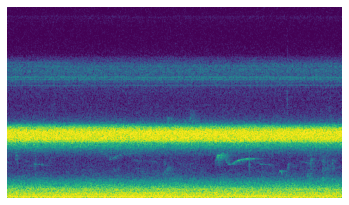

set3/00023757/20210813_STUDY/20210813T063140-0500_Rec_649.png
Detection:  No detection
Confidence:  1.0


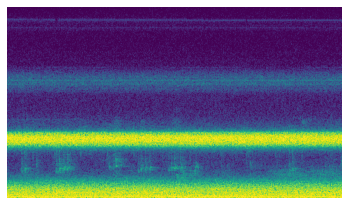

set3/00023757/20210813_STUDY/20210813T063140-0500_Rec_1260.png
Detection:  Green Heron
Confidence:  0.11958969


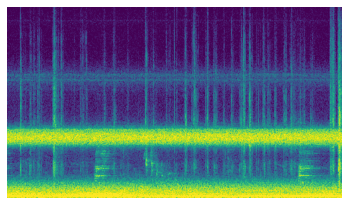

set3/00023795/20210818_STUDY/20210818T063146-0500_Rec_549.png
Detection:  Blue Jay
Confidence:  0.66980296
Detection:  Blue Jay
Confidence:  0.8752938
Detection:  Blue Jay
Confidence:  0.5511154


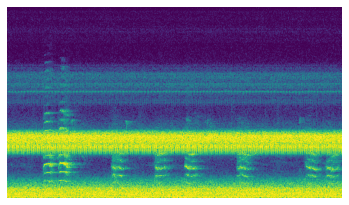

set3/00023757/20210813_STUDY/20210813T063140-0500_Rec_55.png
Detection:  Eastern Wood-Pewee
Confidence:  0.44075075


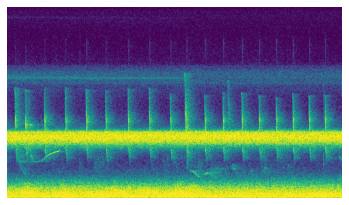

set3/00023757/20210819_STUDY/20210819T063147-0500_Rec_416.png
Detection:  Blue Jay
Confidence:  0.8386517
Detection:  Blue Jay
Confidence:  0.93933153
Detection:  Blue Jay
Confidence:  0.9594192


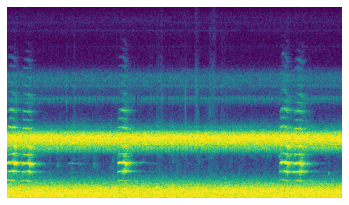

set3/00023757/20210817_STUDY/20210817T063147-0500_Rec_658.png
Detection:  No detection
Confidence:  1.0


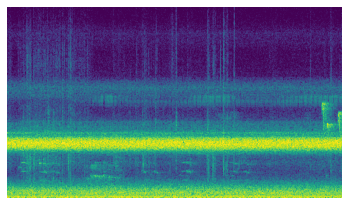

set3/00023795/20210818_STUDY/20210818T063146-0500_Rec_732.png
Detection:  Eastern Phoebe
Confidence:  0.34792063
Detection:  Eastern Wood-Pewee
Confidence:  0.16316134
Detection:  Eastern Wood-Pewee
Confidence:  0.99207276


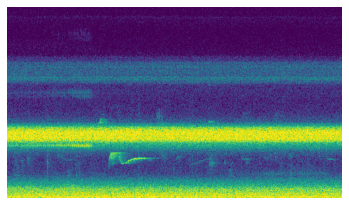

set3/00023757/20210819_STUDY/20210819T063147-0500_Rec_371.png
Detection:  Ovenbird
Confidence:  0.12063159


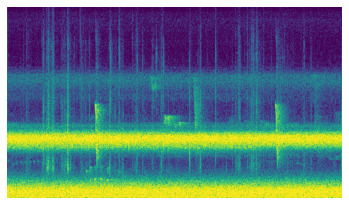

set3/00023757/20210813_STUDY/20210813T063140-0500_Rec_807.png
Detection:  Eastern Bluebird
Confidence:  0.8566971
Detection:  Baltimore Oriole
Confidence:  0.11558263
Detection:  Eastern Wood-Pewee
Confidence:  0.8834825


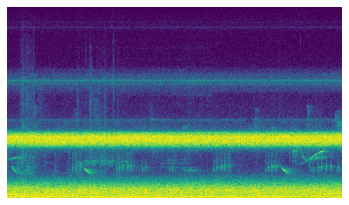

set3/00023795/20210818_STUDY/20210818T063146-0500_Rec_866.png
Detection:  Eastern Wood-Pewee
Confidence:  0.23027153
Detection:  Eastern Wood-Pewee
Confidence:  0.94240916


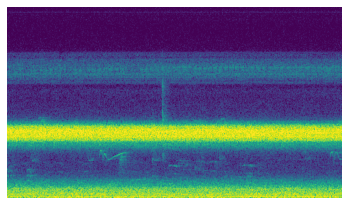

set3/00023757/20210813_STUDY/20210813T063140-0500_Rec_1034.png
Detection:  No detection
Confidence:  1.0


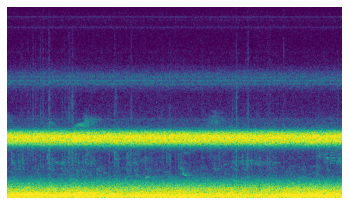

set3/00023757/20210813_STUDY/20210813T063140-0500_Rec_678.png
Detection:  Eastern Wood-Pewee
Confidence:  0.12058904


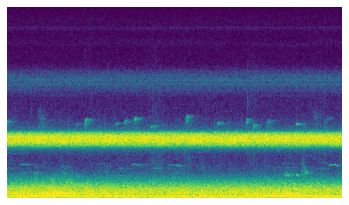

set3/00023757/20210818_STUDY/20210818T063147-0500_Rec_855.png
Detection:  White-breasted Nuthatch
Confidence:  0.4153635
Detection:  Red-headed Woodpecker
Confidence:  0.13615695


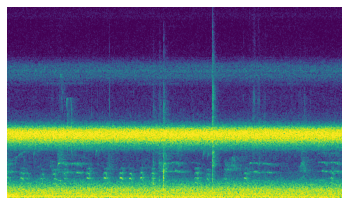

set3/00023757/20210813_STUDY/20210813T063140-0500_Rec_769.png
Detection:  Eastern Wood-Pewee
Confidence:  0.9873203
Detection:  Eastern Wood-Pewee
Confidence:  0.4218912


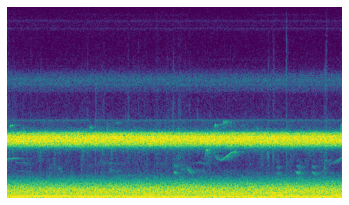

set3/00023757/20210818_STUDY/20210818T063147-0500_Rec_819.png
Detection:  Red-eyed Vireo
Confidence:  0.24039112
Detection:  Red-eyed Vireo
Confidence:  0.13273343


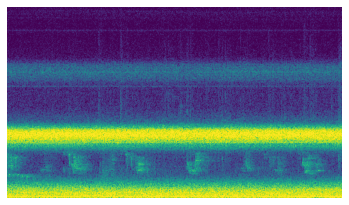

set3/00023757/20210819_STUDY/20210819T063147-0500_Rec_856.png
Detection:  No detection
Confidence:  1.0


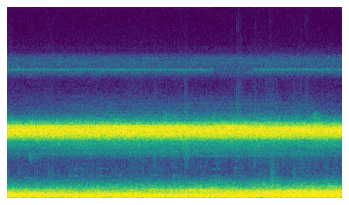

set3/00023757/20210820_STUDY/20210820T063147-0500_Rec_713.png
Detection:  Eastern Wood-Pewee
Confidence:  0.96899474
Detection:  Eastern Wood-Pewee
Confidence:  0.9952827


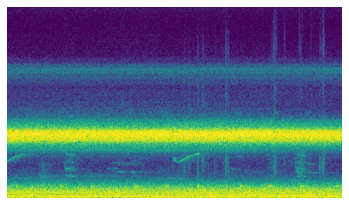

set3/00023757/20210820_STUDY/20210820T063147-0500_Rec_571.png
Detection:  Red-eyed Vireo
Confidence:  0.13836934
Detection:  Scarlet Tanager
Confidence:  0.10764347
Detection:  Yellow-throated Vireo
Confidence:  0.13915215


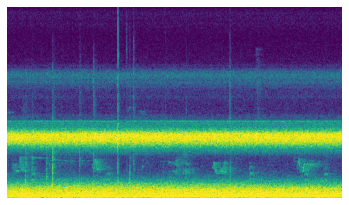

set3/00023757/20210818_STUDY/20210818T063147-0500_Rec_694.png
Detection:  Ovenbird
Confidence:  0.13542245
Detection:  Ovenbird
Confidence:  0.24667437
Detection:  Ovenbird
Confidence:  0.12920532


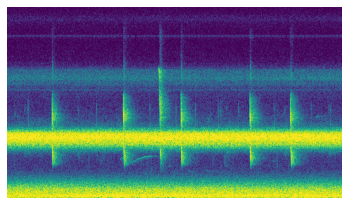

set3/00023757/20210813_STUDY/20210813T030845-0500_Rec_1226.png
Detection:  Red-headed Woodpecker
Confidence:  0.292256
Detection:  Eastern Wood-Pewee
Confidence:  0.9928369
Detection:  Eastern Wood-Pewee
Confidence:  0.99382496


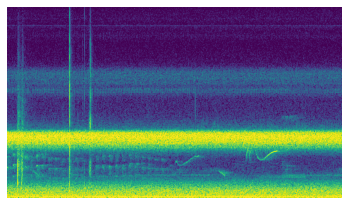

set3/00023757/20210813_STUDY/20210813T063140-0500_Rec_597.png
Detection:  Eastern Wood-Pewee
Confidence:  0.99707735


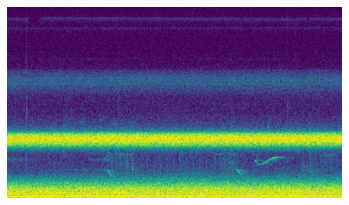

set3/00023757/20210818_STUDY/20210818T063147-0500_Rec_685.png
Detection:  Ovenbird
Confidence:  0.39069015


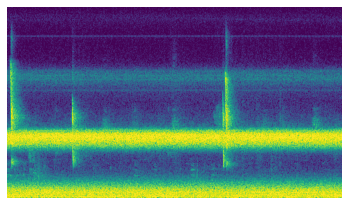

set3/00023757/20210820_STUDY/20210820T030852-0500_Rec_1193.png
Detection:  Eastern Wood-Pewee
Confidence:  0.98688203
Detection:  Eastern Wood-Pewee
Confidence:  0.95480007
Detection:  Eastern Wood-Pewee
Confidence:  0.7981225


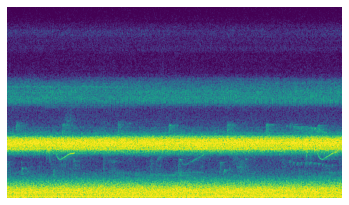

set3/00023757/20210813_STUDY/20210813T063140-0500_Rec_515.png
Detection:  Eastern Wood-Pewee
Confidence:  0.94818866
Detection:  Eastern Wood-Pewee
Confidence:  0.73457134
Detection:  Eastern Wood-Pewee
Confidence:  0.8331376


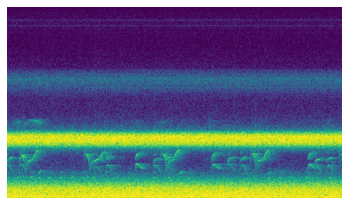

set3/00023795/20210813_STUDY/20210813T063140-0500_Rec_83.png
Detection:  Eastern Wood-Pewee
Confidence:  0.992757
Detection:  Eastern Wood-Pewee
Confidence:  0.9764624


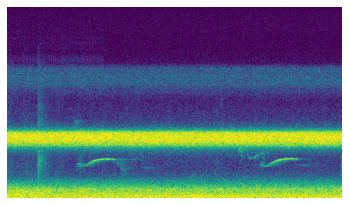

set3/00023757/20210819_STUDY/20210819T063147-0500_Rec_827.png
Detection:  Blue Jay
Confidence:  0.20038155
Detection:  Red-headed Woodpecker
Confidence:  0.12044194


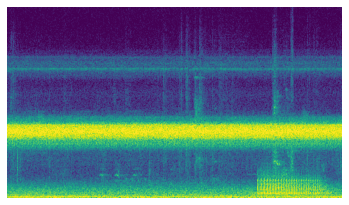

set3/00023795/20210818_STUDY/20210818T063146-0500_Rec_451.png
Detection:  Least Flycatcher
Confidence:  0.10118705


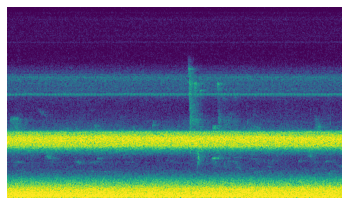

set3/00023757/20210817_STUDY/20210817T063147-0500_Rec_656.png
Detection:  Blue Jay
Confidence:  0.18399723
Detection:  Blue Jay
Confidence:  0.107086025


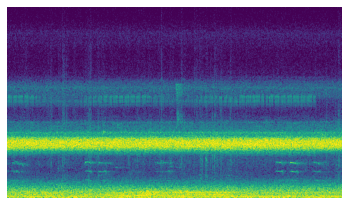

set3/00023757/20210818_STUDY/20210818T063147-0500_Rec_334.png
Detection:  Mourning Dove
Confidence:  0.11550353


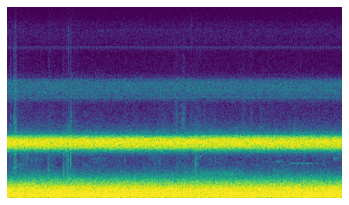

set3/00023757/20210813_STUDY/20210813T063140-0500_Rec_1075.png
Detection:  Blue Jay
Confidence:  0.17399839
Detection:  Eastern Wood-Pewee
Confidence:  0.265736


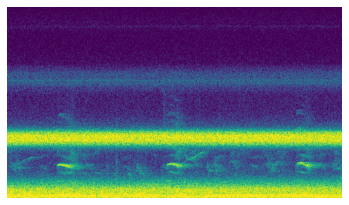

set3/00023757/20210818_STUDY/20210818T063147-0500_Rec_260.png
Detection:  No detection
Confidence:  1.0


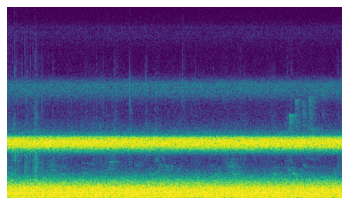

set3/00023757/20210819_STUDY/20210819T063147-0500_Rec_802.png
Detection:  Downy Woodpecker
Confidence:  0.15536575
Detection:  Red-headed Woodpecker
Confidence:  0.14496219
Detection:  Red-bellied Woodpecker
Confidence:  0.11892075


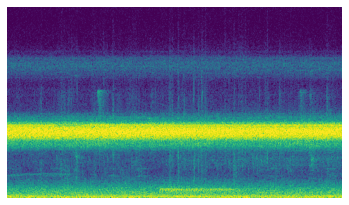

set3/00023757/20210818_STUDY/20210818T063147-0500_Rec_882.png
Detection:  White-breasted Nuthatch
Confidence:  0.98100144
Detection:  White-breasted Nuthatch
Confidence:  0.9884582


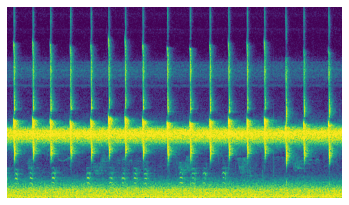

set3/00023757/20210819_STUDY/20210819T030852-0500_Rec_1255.png
Detection:  Ovenbird
Confidence:  0.16164808
Detection:  Ovenbird
Confidence:  0.18528378
Detection:  Ovenbird
Confidence:  0.13866661


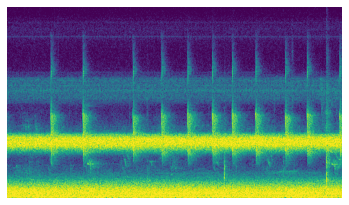

set3/00023757/20210819_STUDY/20210819T030852-0500_Rec_1266.png
Detection:  Ovenbird
Confidence:  0.17005627


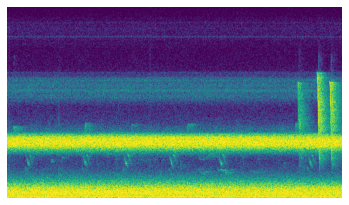

set3/00023795/20210818_STUDY/20210818T063146-0500_Rec_627.png
Detection:  No detection
Confidence:  1.0


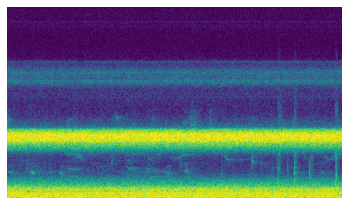

set3/00023757/20210819_STUDY/20210819T063147-0500_Rec_142.png
Detection:  Northern Flicker
Confidence:  0.18141796
Detection:  Red-eyed Vireo
Confidence:  0.20961773


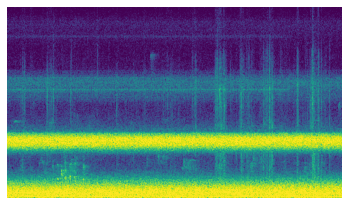

set3/00023795/20210818_STUDY/20210818T063146-0500_Rec_385.png
Detection:  Red-bellied Woodpecker
Confidence:  0.19950616
Detection:  Ruby-throated Hummingbird
Confidence:  0.16623376
Detection:  Ruby-throated Hummingbird
Confidence:  0.298043


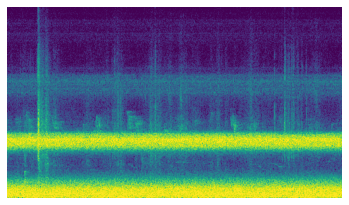

set3/00023757/20210820_STUDY/20210820T063147-0500_Rec_220.png
Detection:  Ruby-throated Hummingbird
Confidence:  0.6667492
Detection:  Ruby-throated Hummingbird
Confidence:  0.6493336
Detection:  Ruby-throated Hummingbird
Confidence:  0.7920336


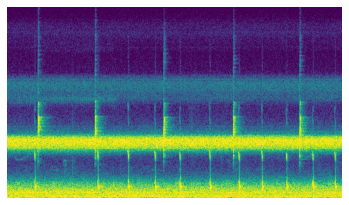

set3/00023757/20210813_STUDY/20210813T063140-0500_Rec_768.png
Detection:  Eastern Wood-Pewee
Confidence:  0.9583593
Detection:  Eastern Wood-Pewee
Confidence:  0.6414728


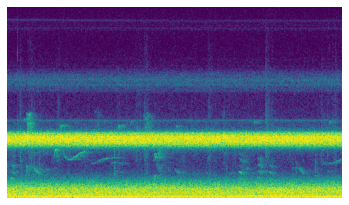

set3/00023795/20210813_STUDY/20210813T063140-0500_Rec_61.png
Detection:  Ovenbird
Confidence:  0.1621466


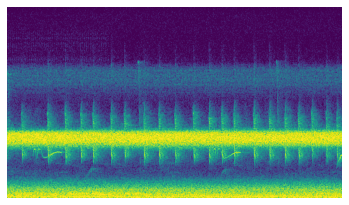

set3/00023757/20210813_STUDY/20210813T063140-0500_Rec_845.png
Detection:  Red-headed Woodpecker
Confidence:  0.11010507
Detection:  Red-bellied Woodpecker
Confidence:  0.10563287


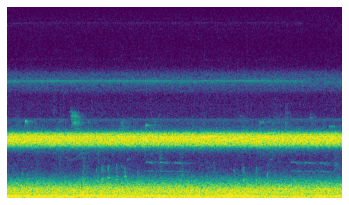

set3/00023757/20210820_STUDY/20210820T063147-0500_Rec_652.png
Detection:  Eastern Wood-Pewee
Confidence:  0.37034565
Detection:  Eastern Wood-Pewee
Confidence:  0.99353725
Detection:  Mourning Dove
Confidence:  0.28501698


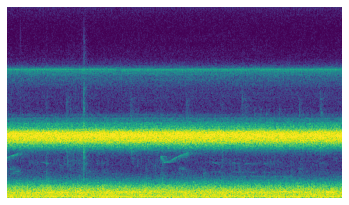

set3/00023757/20210813_STUDY/20210813T063140-0500_Rec_1158.png
Detection:  Blue Jay
Confidence:  0.84532315
Detection:  Blue Jay
Confidence:  0.5844699
Detection:  Blue Jay
Confidence:  0.740918


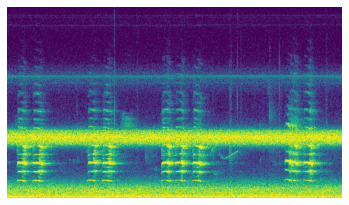

set3/00023795/20210813_STUDY/20210813T063140-0500_Rec_229.png
Detection:  Eastern Wood-Pewee
Confidence:  0.112983815
Detection:  Eastern Wood-Pewee
Confidence:  0.9931815
Detection:  Eastern Wood-Pewee
Confidence:  0.9975313


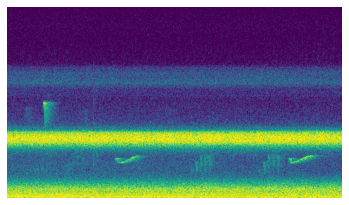

set3/00023757/20210818_STUDY/20210818T030852-0500_Rec_1199.png
Detection:  American Goldfinch
Confidence:  0.22508273
Detection:  Eastern Wood-Pewee
Confidence:  0.436587
Detection:  Yellow-throated Vireo
Confidence:  0.20748203


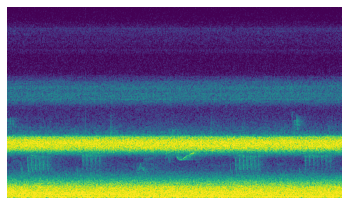

set3/00023795/20210813_STUDY/20210813T063140-0500_Rec_803.png
Detection:  Red-eyed Vireo
Confidence:  0.10431801


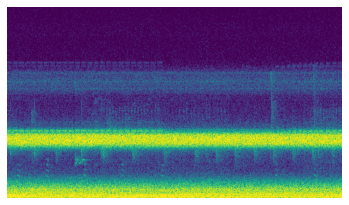

set3/00023757/20210813_STUDY/20210813T063140-0500_Rec_259.png
Detection:  Eastern Wood-Pewee
Confidence:  0.9782447
Detection:  Red-eyed Vireo
Confidence:  0.109481156
Detection:  Northern Flicker
Confidence:  0.12243359


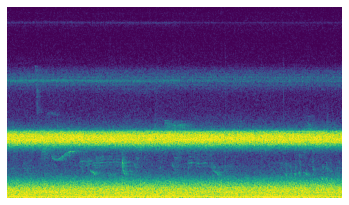

set3/00023757/20210818_STUDY/20210818T063147-0500_Rec_30.png
Detection:  Eastern Wood-Pewee
Confidence:  0.8314207


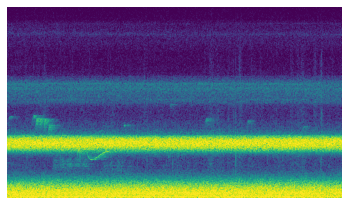

set3/00023757/20210818_STUDY/20210818T063147-0500_Rec_101.png
Detection:  Eastern Wood-Pewee
Confidence:  0.2427303
Detection:  American Goldfinch
Confidence:  0.52690864


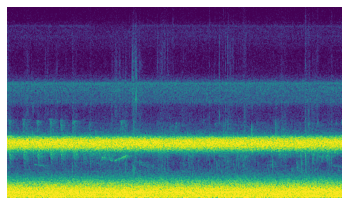

set3/00023795/20210818_STUDY/20210818T063146-0500_Rec_797.png
Detection:  Eastern Wood-Pewee
Confidence:  0.88078576
Detection:  Eastern Wood-Pewee
Confidence:  0.9923051


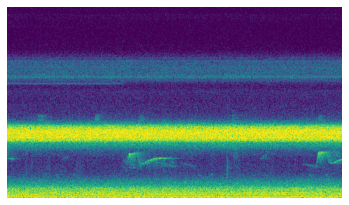

set3/00023795/20210813_STUDY/20210813T063140-0500_Rec_347.png
Detection:  No detection
Confidence:  1.0


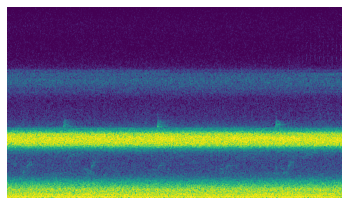

set3/00023757/20210813_STUDY/20210813T063140-0500_Rec_401.png
Detection:  American Goldfinch
Confidence:  0.4310378
Detection:  Baltimore Oriole
Confidence:  0.11727684


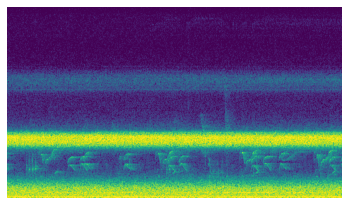

set3/00023757/20210820_STUDY/20210820T063147-0500_Rec_393.png
Detection:  No detection
Confidence:  1.0


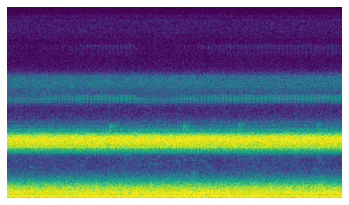

set3/00023757/20210819_STUDY/20210819T030852-0500_Rec_1250.png
Detection:  Ovenbird
Confidence:  0.34154072
Detection:  Ovenbird
Confidence:  0.6243836
Detection:  Ovenbird
Confidence:  0.5590589


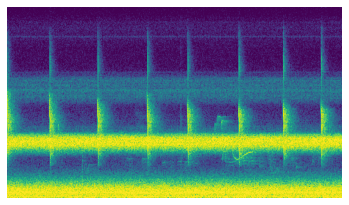

set3/00023757/20210818_STUDY/20210818T063147-0500_Rec_782.png
Detection:  Eastern Wood-Pewee
Confidence:  0.66686076
Detection:  Red-eyed Vireo
Confidence:  0.14349218


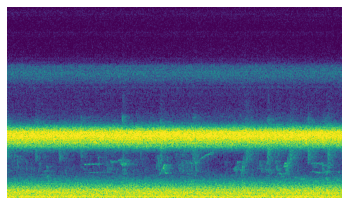

set3/00023757/20210813_STUDY/20210813T063140-0500_Rec_1089.png
Detection:  Blue Jay
Confidence:  0.13971448


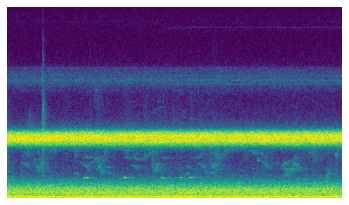

set3/00023757/20210819_STUDY/20210819T063147-0500_Rec_696.png
Detection:  Ovenbird
Confidence:  0.12606221


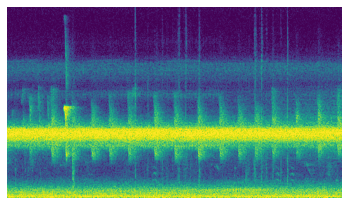

set3/00023757/20210813_STUDY/20210813T063140-0500_Rec_1134.png
Detection:  Blue Jay
Confidence:  0.9747993
Detection:  Blue Jay
Confidence:  0.9649245
Detection:  Blue Jay
Confidence:  0.85962933


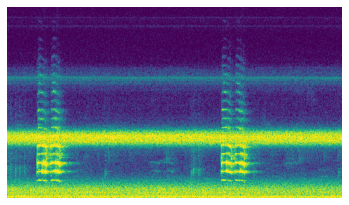

set3/00023757/20210813_STUDY/20210813T030845-0500_Rec_1243.png
Detection:  Eastern Wood-Pewee
Confidence:  0.9931278
Detection:  Eastern Wood-Pewee
Confidence:  0.9831535


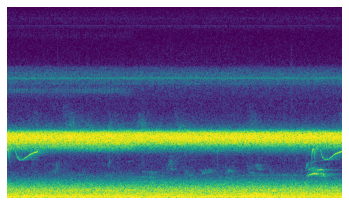

set3/00023757/20210820_STUDY/20210820T030852-0500_Rec_1139.png
Detection:  Eastern Wood-Pewee
Confidence:  0.8180525


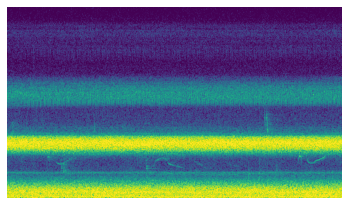

set3/00023757/20210817_STUDY/20210817T063147-0500_Rec_1002.png
Detection:  No detection
Confidence:  1.0


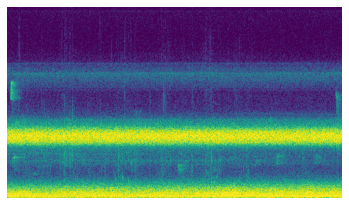

set3/00023757/20210813_STUDY/20210813T063140-0500_Rec_970.png
Detection:  Eastern Wood-Pewee
Confidence:  0.95013577
Detection:  Blue Jay
Confidence:  0.15511674
Detection:  Eastern Wood-Pewee
Confidence:  0.69985336
Detection:  Blue Jay
Confidence:  0.20244758


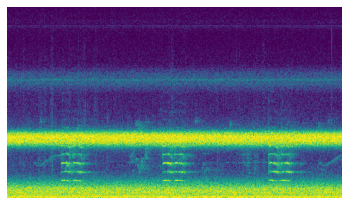

set3/00023757/20210819_STUDY/20210819T063147-0500_Rec_66.png
Detection:  Eastern Wood-Pewee
Confidence:  0.995034
Detection:  Ruby-throated Hummingbird
Confidence:  0.41276556
Detection:  Ovenbird
Confidence:  0.30560112


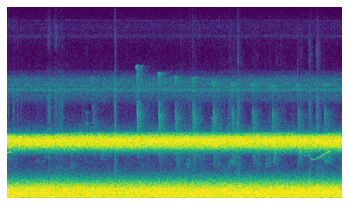

set3/00023757/20210818_STUDY/20210818T063147-0500_Rec_272.png
Detection:  No detection
Confidence:  1.0


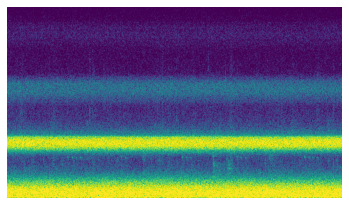

set3/00023795/20210813_STUDY/20210813T063140-0500_Rec_172.png
Detection:  Eastern Wood-Pewee
Confidence:  0.97185576


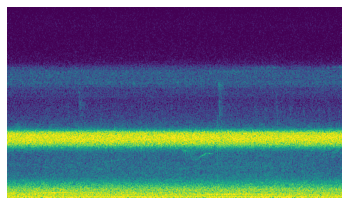

set3/00023757/20210820_STUDY/20210820T063147-0500_Rec_586.png
Detection:  Blue Jay
Confidence:  0.79217476
Detection:  Blue Jay
Confidence:  0.20391794
Detection:  Blue Jay
Confidence:  0.85441136


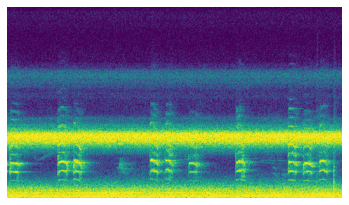

set3/00023757/20210813_STUDY/20210813T063140-0500_Rec_41.png
Detection:  Eastern Wood-Pewee
Confidence:  0.97384936


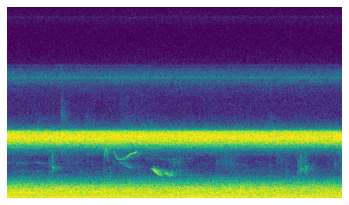

set3/00023757/20210818_STUDY/20210818T063147-0500_Rec_464.png
Detection:  Red-eyed Vireo
Confidence:  0.36189395


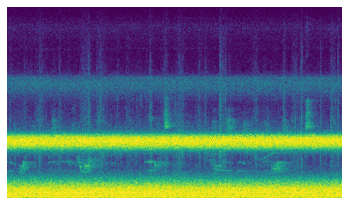

set3/00023757/20210813_STUDY/20210813T063140-0500_Rec_114.png
Detection:  Downy Woodpecker
Confidence:  0.3585384
Detection:  Red-headed Woodpecker
Confidence:  0.30974975
Detection:  Blue Jay
Confidence:  0.17900042
Detection:  Blue Jay
Confidence:  0.18832831
Detection:  Red-headed Woodpecker
Confidence:  0.18851288
Detection:  Downy Woodpecker
Confidence:  0.16790332


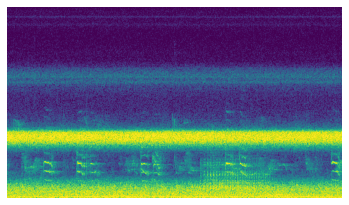

set3/00023757/20210819_STUDY/20210819T063147-0500_Rec_241.png
Detection:  Ovenbird
Confidence:  0.15935327
Detection:  Ovenbird
Confidence:  0.18137813
Detection:  Ovenbird
Confidence:  0.1887241


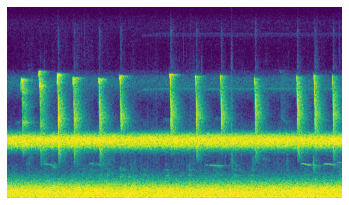

set3/00023757/20210819_STUDY/20210819T063147-0500_Rec_584.png
Detection:  Blue Jay
Confidence:  0.10089578


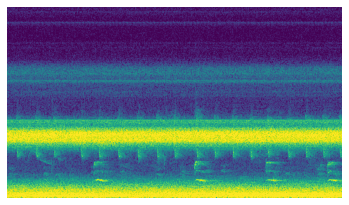

set3/00023757/20210819_STUDY/20210819T030852-0500_Rec_1215.png
Detection:  Red-headed Woodpecker
Confidence:  0.13945574


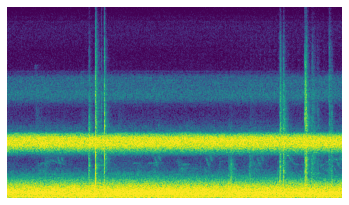

set3/00023757/20210820_STUDY/20210820T030852-0500_Rec_1334.png
Detection:  No detection
Confidence:  1.0


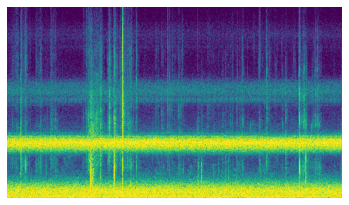

set3/00023795/20210819_STUDY/20210819T063146-0500_Rec_401.png
Detection:  Eastern Wood-Pewee
Confidence:  0.95204604


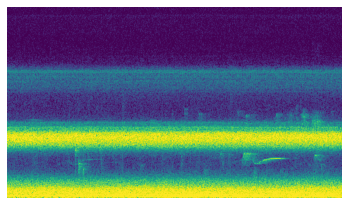

set3/00023757/20210817_STUDY/20210817T063147-0500_Rec_504.png
Detection:  No detection
Confidence:  1.0


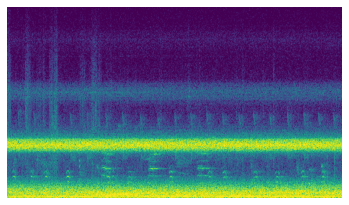

set3/00023757/20210813_STUDY/20210813T063140-0500_Rec_326.png
Detection:  No detection
Confidence:  1.0


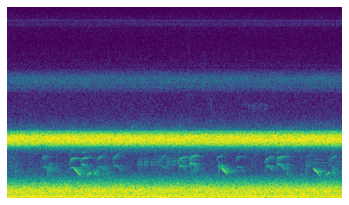

set3/00023757/20210818_STUDY/20210818T063147-0500_Rec_208.png
Detection:  No detection
Confidence:  1.0


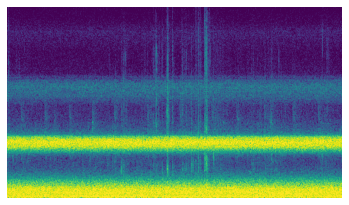

set3/00023757/20210813_STUDY/20210813T030845-0500_Rec_1299.png
Detection:  Yellow-throated Vireo
Confidence:  0.4723145
Detection:  Red-eyed Vireo
Confidence:  0.12298062
Detection:  Yellow-throated Vireo
Confidence:  0.30169687
Detection:  Eastern Wood-Pewee
Confidence:  0.22522196


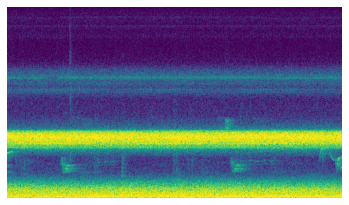

set3/00023757/20210813_STUDY/20210813T063140-0500_Rec_1073.png
Detection:  Red-headed Woodpecker
Confidence:  0.106722414
Detection:  Eastern Wood-Pewee
Confidence:  0.99212646


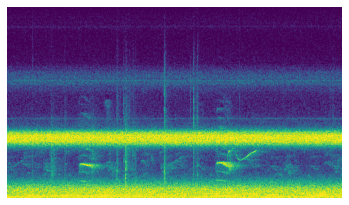

set3/00023757/20210819_STUDY/20210819T030852-0500_Rec_1178.png
Detection:  Eastern Wood-Pewee
Confidence:  0.8908318


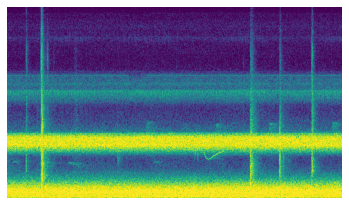

set3/00023757/20210818_STUDY/20210818T063147-0500_Rec_1008.png
Detection:  Red-eyed Vireo
Confidence:  0.2556855
Detection:  Red-eyed Vireo
Confidence:  0.23096713


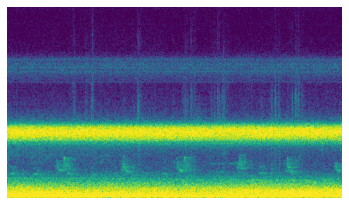

set3/00023757/20210819_STUDY/20210819T063147-0500_Rec_32.png
Detection:  No detection
Confidence:  1.0


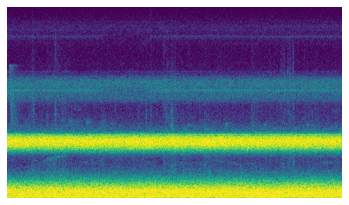

set3/00023757/20210818_STUDY/20210818T030852-0500_Rec_1096.png
Detection:  No detection
Confidence:  1.0


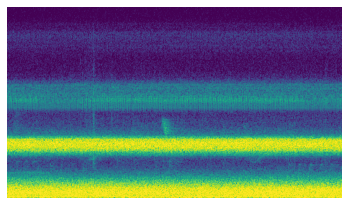

set3/00023757/20210819_STUDY/20210819T063147-0500_Rec_204.png
Detection:  No detection
Confidence:  1.0


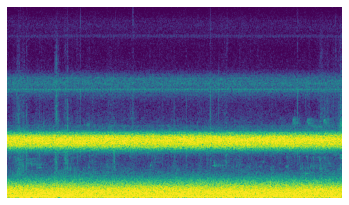

set3/00023757/20210820_STUDY/20210820T063147-0500_Rec_399.png
Detection:  No detection
Confidence:  1.0


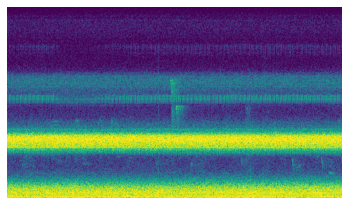

set3/00023757/20210819_STUDY/20210819T063147-0500_Rec_216.png
Detection:  Ovenbird
Confidence:  0.18792123


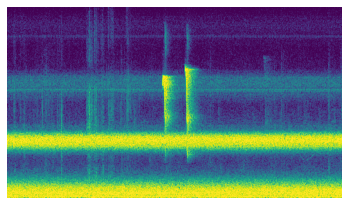

set3/00023757/20210819_STUDY/20210819T063147-0500_Rec_108.png
Detection:  Red-headed Woodpecker
Confidence:  0.14056295


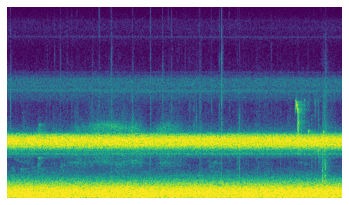

set3/00023795/20210813_STUDY/20210813T063140-0500_Rec_133.png
Detection:  Northern Cardinal
Confidence:  0.92332643
Detection:  Northern Cardinal
Confidence:  0.9435634
Detection:  Northern Cardinal
Confidence:  0.76917285


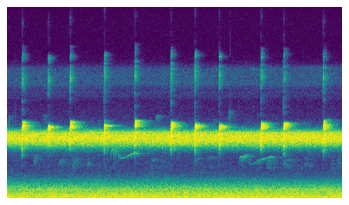

set3/00023757/20210817_STUDY/20210817T063147-0500_Rec_768.png
Detection:  White-breasted Nuthatch
Confidence:  0.6374417
Detection:  Red-headed Woodpecker
Confidence:  0.17227109
Detection:  Blue Jay
Confidence:  0.17214237
Detection:  Blue Jay
Confidence:  0.11447686


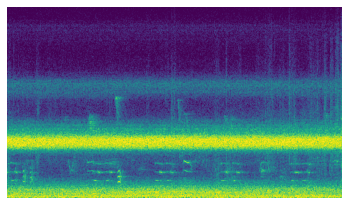

set3/00023757/20210817_STUDY/20210817T063147-0500_Rec_728.png
Detection:  Blue Jay
Confidence:  0.12634762
Detection:  Red-headed Woodpecker
Confidence:  0.12520857
Detection:  Chipping Sparrow
Confidence:  0.111112215
Detection:  Red-headed Woodpecker
Confidence:  0.2590734


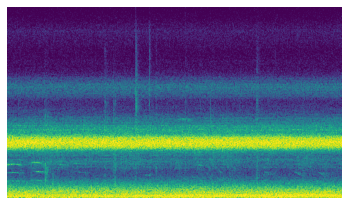

set3/00023757/20210818_STUDY/20210818T063147-0500_Rec_198.png
Detection:  No detection
Confidence:  1.0


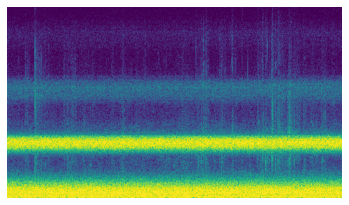

set3/00023757/20210820_STUDY/20210820T063147-0500_Rec_457.png
Detection:  Red-eyed Vireo
Confidence:  0.11592347
Detection:  Yellow-throated Vireo
Confidence:  0.20637083


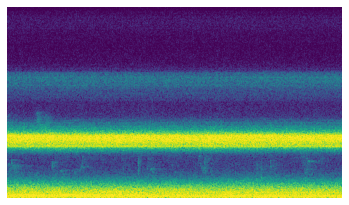

set3/00023757/20210818_STUDY/20210818T063147-0500_Rec_644.png
Detection:  Eastern Wood-Pewee
Confidence:  0.99075854
Detection:  Eastern Wood-Pewee
Confidence:  0.78235406
Detection:  Ovenbird
Confidence:  0.1406999
Detection:  Ovenbird
Confidence:  0.13292082


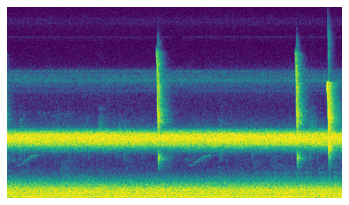

set3/00023757/20210819_STUDY/20210819T063147-0500_Rec_342.png
Detection:  Ovenbird
Confidence:  0.59517
Detection:  Ovenbird
Confidence:  0.4312489
Detection:  Ovenbird
Confidence:  0.20987839


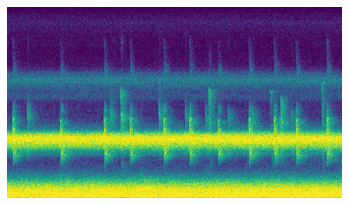

set3/00023757/20210818_STUDY/20210818T063147-0500_Rec_472.png
Detection:  Yellow-throated Vireo
Confidence:  0.115084514
Detection:  Eastern Wood-Pewee
Confidence:  0.29299194


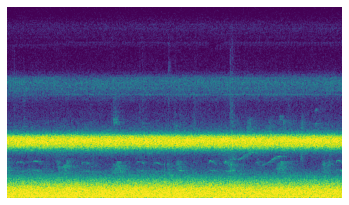

set3/00023757/20210818_STUDY/20210818T063147-0500_Rec_45.png
Detection:  Eastern Wood-Pewee
Confidence:  0.9632559


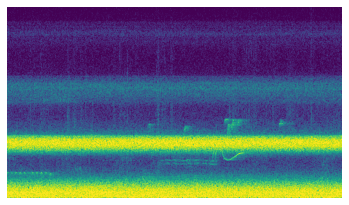

set3/00023757/20210820_STUDY/20210820T063147-0500_Rec_718.png
Detection:  Ruby-throated Hummingbird
Confidence:  0.41273534
Detection:  Eastern Wood-Pewee
Confidence:  0.37176034
Detection:  Eastern Wood-Pewee
Confidence:  0.4854875


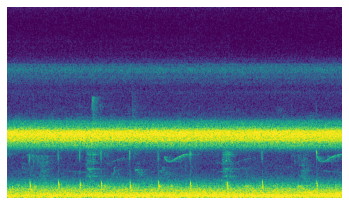

set3/00023757/20210817_STUDY/20210817T063147-0500_Rec_1037.png
Detection:  Chipping Sparrow
Confidence:  0.15054622


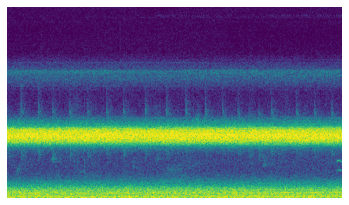

set3/00023757/20210820_STUDY/20210820T030852-0500_Rec_1254.png
Detection:  Red-headed Woodpecker
Confidence:  0.19633387


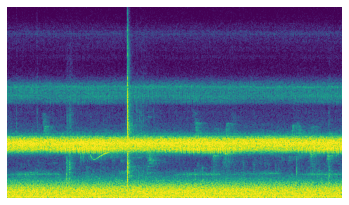

set3/00023757/20210817_STUDY/20210817T063147-0500_Rec_602.png
Detection:  Ovenbird
Confidence:  0.11650406


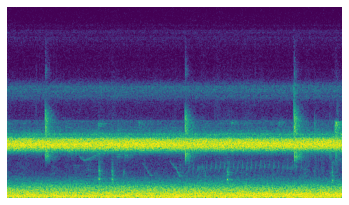

set3/00023757/20210818_STUDY/20210818T063147-0500_Rec_823.png
Detection:  Red-eyed Vireo
Confidence:  0.16020249


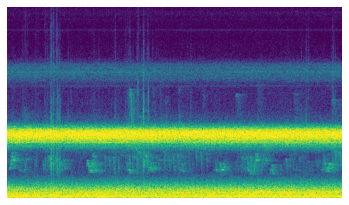

set3/00023757/20210818_STUDY/20210818T030852-0500_Rec_1090.png
Detection:  Eastern Wood-Pewee
Confidence:  0.9570371
Detection:  Eastern Wood-Pewee
Confidence:  0.97993934


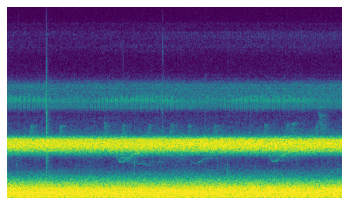

set3/00023757/20210813_STUDY/20210813T063140-0500_Rec_679.png
Detection:  No detection
Confidence:  1.0


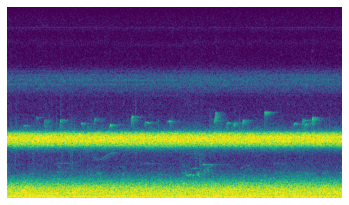

set3/00023795/20210818_STUDY/20210818T063146-0500_Rec_392.png
Detection:  Cedar Waxwing
Confidence:  0.22804108


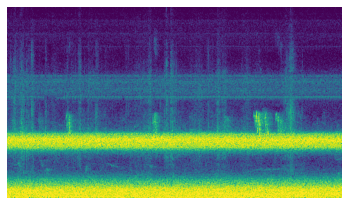

set3/00023757/20210817_STUDY/20210817T063147-0500_Rec_645.png
Detection:  No detection
Confidence:  1.0


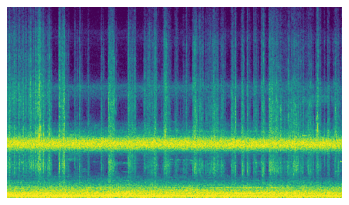

set3/00023757/20210818_STUDY/20210818T030852-0500_Rec_1048.png
Detection:  No detection
Confidence:  1.0


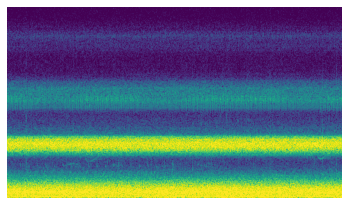

set3/00023795/20210813_STUDY/20210813T063140-0500_Rec_351.png
Detection:  Yellow-throated Vireo
Confidence:  0.4962177
Detection:  Red-eyed Vireo
Confidence:  0.102029696


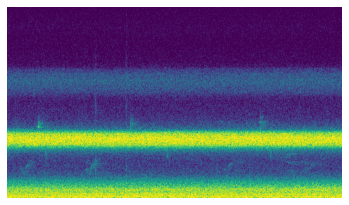

set3/00023757/20210813_STUDY/20210813T063140-0500_Rec_286.png
Detection:  Eastern Bluebird
Confidence:  0.2040174
Detection:  Indigo Bunting
Confidence:  0.11445719


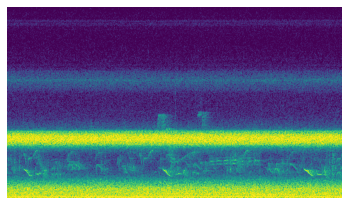

set3/00023795/20210813_STUDY/20210813T063140-0500_Rec_758.png
Detection:  Eastern Wood-Pewee
Confidence:  0.7973176


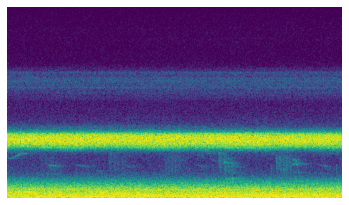

set3/00023757/20210819_STUDY/20210819T063147-0500_Rec_592.png
Detection:  Eastern Wood-Pewee
Confidence:  0.9498321
Detection:  Blue Jay
Confidence:  0.20032191
Detection:  Ovenbird
Confidence:  0.14762828


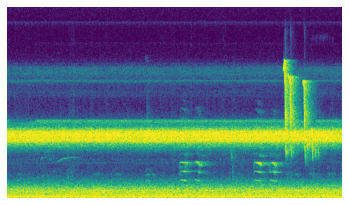

set3/00023795/20210813_STUDY/20210813T063140-0500_Rec_74.png
Detection:  No detection
Confidence:  1.0


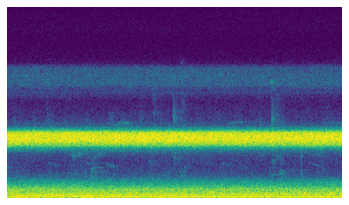

set3/00023757/20210820_STUDY/20210820T063147-0500_Rec_650.png
Detection:  Eastern Wood-Pewee
Confidence:  0.9869446
Detection:  Eastern Wood-Pewee
Confidence:  0.99027425
Detection:  Eastern Wood-Pewee
Confidence:  0.9257218
Detection:  Blue Jay
Confidence:  0.21179727


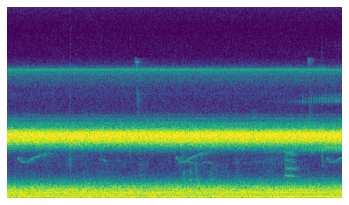

set3/00023757/20210813_STUDY/20210813T063140-0500_Rec_767.png
Detection:  Eastern Wood-Pewee
Confidence:  0.9547729
Detection:  Eastern Bluebird
Confidence:  0.16252938
Detection:  Blue Jay
Confidence:  0.10515212


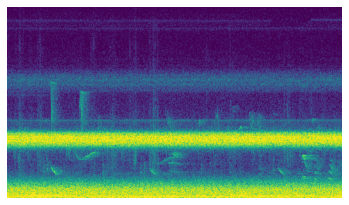

set3/00023757/20210818_STUDY/20210818T063147-0500_Rec_844.png
Detection:  No detection
Confidence:  1.0


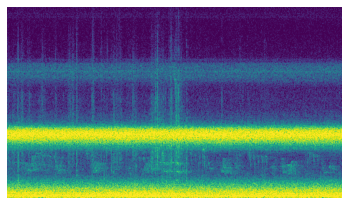

set3/00023757/20210813_STUDY/20210813T063140-0500_Rec_804.png
Detection:  Eastern Wood-Pewee
Confidence:  0.93812966
Detection:  Eastern Wood-Pewee
Confidence:  0.44541657
Detection:  Eastern Wood-Pewee
Confidence:  0.7137476


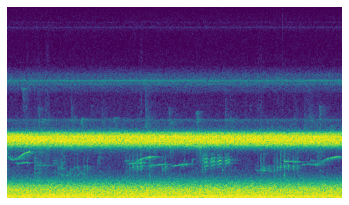

set3/00023757/20210813_STUDY/20210813T063140-0500_Rec_629.png
Detection:  Eastern Bluebird
Confidence:  0.7946155
Detection:  Olive-sided Flycatcher
Confidence:  0.13234094


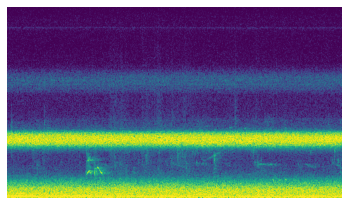

set3/00023757/20210813_STUDY/20210813T063140-0500_Rec_276.png
Detection:  Eastern Wood-Pewee
Confidence:  0.93308234
Detection:  Baltimore Oriole
Confidence:  0.11052826
Detection:  Eastern Wood-Pewee
Confidence:  0.19273871


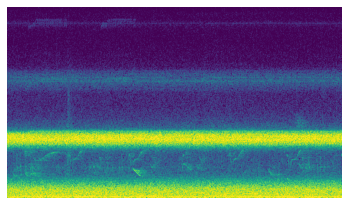

set3/00023771/20210817_STUDY/20210817T063147-0500_Rec_529.png
Detection:  No detection
Confidence:  1.0


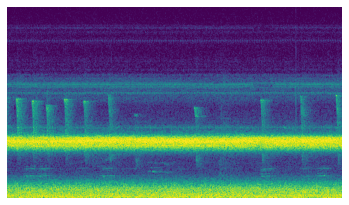

set3/00023757/20210813_STUDY/20210813T063140-0500_Rec_499.png
Detection:  Eastern Wood-Pewee
Confidence:  0.14655234
Detection:  Eastern Wood-Pewee
Confidence:  0.9841681
Detection:  Eastern Wood-Pewee
Confidence:  0.9225609


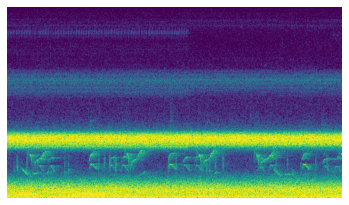

set3/00023757/20210817_STUDY/20210817T063147-0500_Rec_770.png
Detection:  Ruby-throated Hummingbird
Confidence:  0.20385118
Detection:  Red-headed Woodpecker
Confidence:  0.31040272
Detection:  Red-bellied Woodpecker
Confidence:  0.124548525


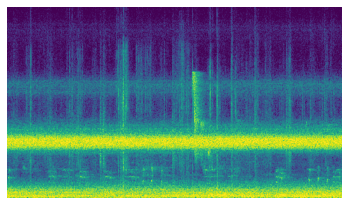

set3/00023757/20210819_STUDY/20210819T063147-0500_Rec_521.png
Detection:  Ovenbird
Confidence:  0.5014148
Detection:  Ovenbird
Confidence:  0.681895
Detection:  Ovenbird
Confidence:  0.23870192


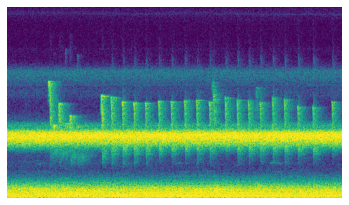

set3/00023757/20210813_STUDY/20210813T063140-0500_Rec_5.png
Detection:  Eastern Wood-Pewee
Confidence:  0.9893693


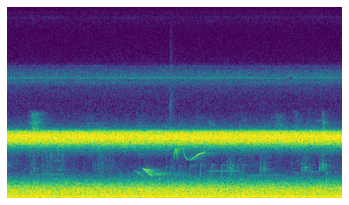

set3/00023757/20210819_STUDY/20210819T063147-0500_Rec_478.png
Detection:  No detection
Confidence:  1.0


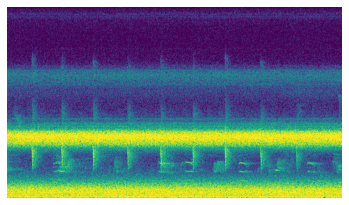

set3/00023757/20210819_STUDY/20210819T063147-0500_Rec_798.png
Detection:  Red-headed Woodpecker
Confidence:  0.1464279


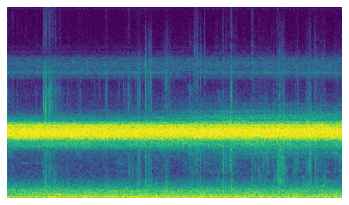

set3/00023757/20210813_STUDY/20210813T063140-0500_Rec_178.png
Detection:  Eastern Bluebird
Confidence:  0.36202177
Detection:  Baltimore Oriole
Confidence:  0.12533219
Detection:  Baltimore Oriole
Confidence:  0.53653187


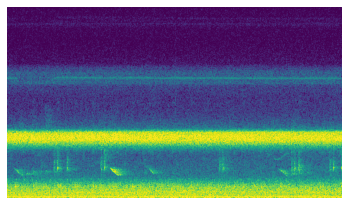

set3/00023795/20210818_STUDY/20210818T063146-0500_Rec_467.png
Detection:  Red-bellied Woodpecker
Confidence:  0.14362583
Detection:  Eastern Wood-Pewee
Confidence:  0.9853402


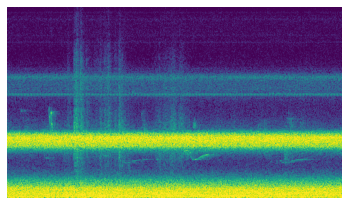

set3/00023795/20210818_STUDY/20210818T063146-0500_Rec_584.png
Detection:  No detection
Confidence:  1.0


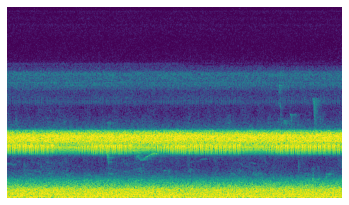

set3/00023757/20210820_STUDY/20210820T063147-0500_Rec_362.png
Detection:  Eastern Wood-Pewee
Confidence:  0.9745895


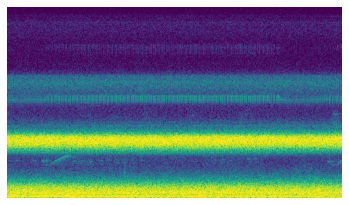

set3/00023757/20210818_STUDY/20210818T063147-0500_Rec_975.png
Detection:  No detection
Confidence:  1.0


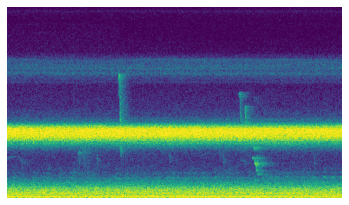

set3/00023757/20210818_STUDY/20210818T030852-0500_Rec_1264.png
Detection:  Eastern Wood-Pewee
Confidence:  0.71818584
Detection:  Eastern Wood-Pewee
Confidence:  0.5641244


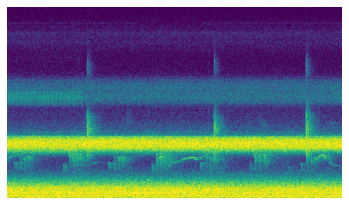

set3/00023757/20210820_STUDY/20210820T030852-0500_Rec_1069.png
Detection:  House Wren
Confidence:  0.20075451


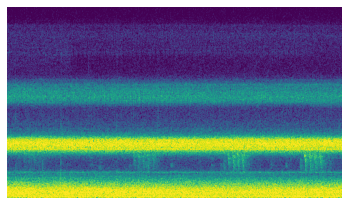

set3/00023757/20210819_STUDY/20210819T063147-0500_Rec_270.png
Detection:  No detection
Confidence:  1.0


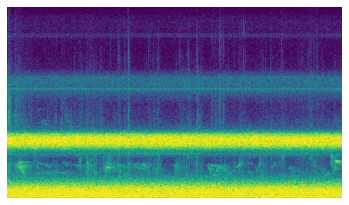

set3/00023757/20210813_STUDY/20210813T063140-0500_Rec_1038.png
Detection:  Red-tailed Hawk
Confidence:  0.17140767


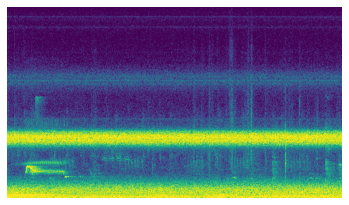

set3/00023757/20210819_STUDY/20210819T030852-0500_Rec_1192.png
Detection:  Eastern Wood-Pewee
Confidence:  0.9446076


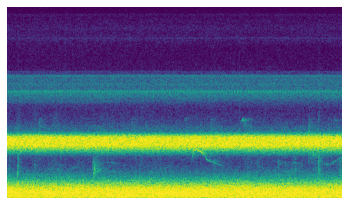

set3/00023757/20210819_STUDY/20210819T063147-0500_Rec_645.png
Detection:  No detection
Confidence:  1.0


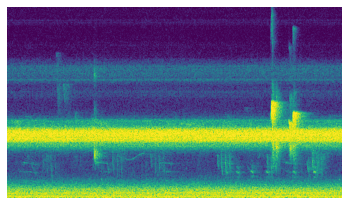

set3/00023757/20210813_STUDY/20210813T063140-0500_Rec_39.png
Detection:  Scarlet Tanager
Confidence:  0.17034636
Detection:  Eastern Wood-Pewee
Confidence:  0.9189963


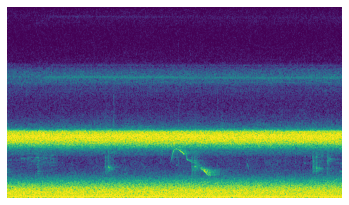

set3/00023757/20210820_STUDY/20210820T063147-0500_Rec_155.png
Detection:  Ruby-throated Hummingbird
Confidence:  0.21602108
Detection:  Northern Waterthrush
Confidence:  0.13243234
Detection:  Ruby-throated Hummingbird
Confidence:  0.5173157


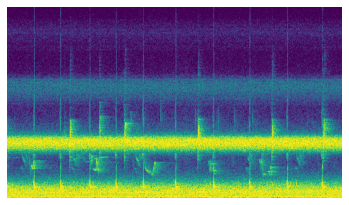

set3/00023795/20210813_STUDY/20210813T063140-0500_Rec_110.png
Detection:  No detection
Confidence:  1.0


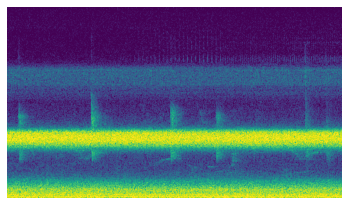

set3/00023795/20210813_STUDY/20210813T063140-0500_Rec_320.png
Detection:  No detection
Confidence:  1.0


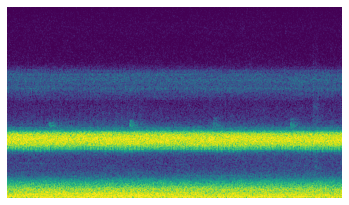

set3/00023757/20210818_STUDY/20210818T063147-0500_Rec_1006.png
Detection:  No detection
Confidence:  1.0


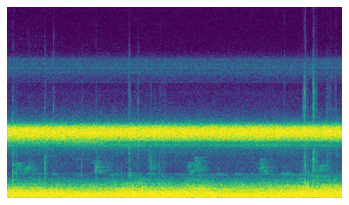

set3/00023757/20210813_STUDY/20210813T030845-0500_Rec_1282.png
Detection:  Mourning Dove
Confidence:  0.11369887
Detection:  Red-eyed Vireo
Confidence:  0.35443598


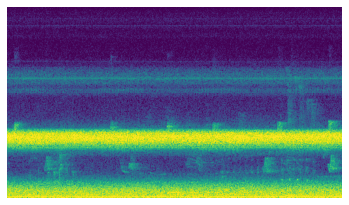

set3/00023757/20210819_STUDY/20210819T063147-0500_Rec_380.png
Detection:  Ovenbird
Confidence:  0.3351129
Detection:  Ovenbird
Confidence:  0.54194856
Detection:  Ovenbird
Confidence:  0.28888413


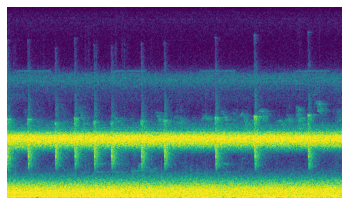

set3/00023757/20210818_STUDY/20210818T063147-0500_Rec_39.png
Detection:  Eastern Wood-Pewee
Confidence:  0.19022968


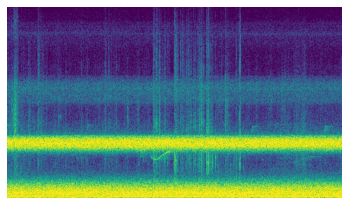

set3/00023795/20210813_STUDY/20210813T063140-0500_Rec_259.png
Detection:  No detection
Confidence:  1.0


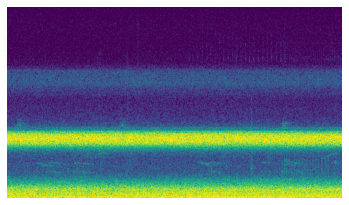

set3/00023757/20210819_STUDY/20210819T063147-0500_Rec_577.png
Detection:  Ovenbird
Confidence:  0.2940714


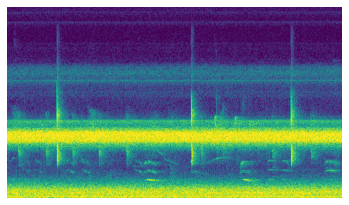

set3/00023757/20210813_STUDY/20210813T063140-0500_Rec_600.png
Detection:  Eastern Wood-Pewee
Confidence:  0.9336162
Detection:  Eastern Wood-Pewee
Confidence:  0.99266946


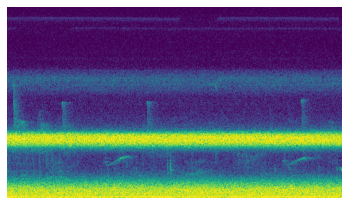

set3/00023757/20210817_STUDY/20210817T063147-0500_Rec_641.png
Detection:  Ruby-throated Hummingbird
Confidence:  0.8525813
Detection:  Ruby-throated Hummingbird
Confidence:  0.2083761


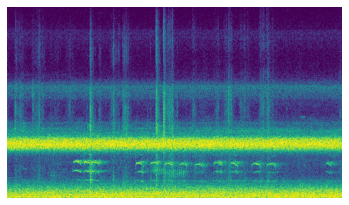

set3/00023757/20210817_STUDY/20210817T063147-0500_Rec_744.png
Detection:  Blue Jay
Confidence:  0.18390585
Detection:  Blue Jay
Confidence:  0.26674643
Detection:  Blue Jay
Confidence:  0.28282994


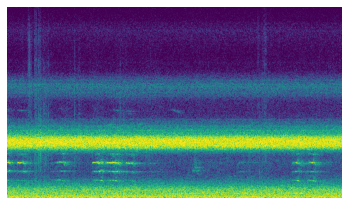

set3/00023757/20210820_STUDY/20210820T030852-0500_Rec_1280.png
Detection:  Eastern Wood-Pewee
Confidence:  0.97561854


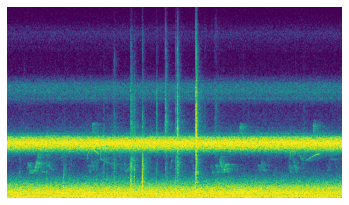

set3/00023757/20210813_STUDY/20210813T063140-0500_Rec_1077.png
Detection:  Eastern Wood-Pewee
Confidence:  0.5695054


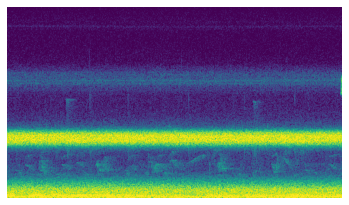

set3/00023795/20210813_STUDY/20210813T063140-0500_Rec_1037.png
Detection:  Eastern Wood-Pewee
Confidence:  0.8629237


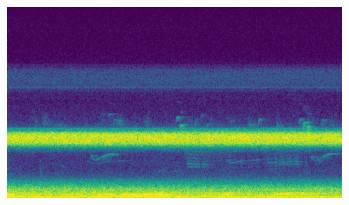

set3/00023757/20210818_STUDY/20210818T063147-0500_Rec_481.png
Detection:  Eastern Wood-Pewee
Confidence:  0.97235185


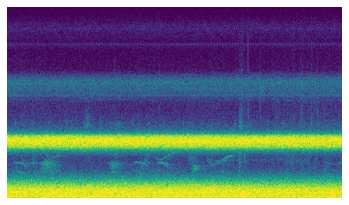

set3/00023757/20210813_STUDY/20210813T063140-0500_Rec_676.png
Detection:  No detection
Confidence:  1.0


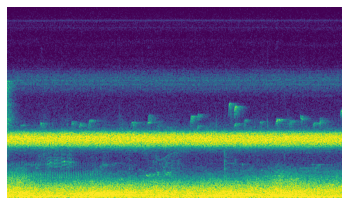

set3/00023757/20210818_STUDY/20210818T063147-0500_Rec_816.png
Detection:  Ovenbird
Confidence:  0.15977973
Detection:  Red-eyed Vireo
Confidence:  0.109070934


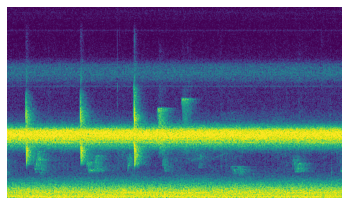

set3/00023795/20210813_STUDY/20210813T063140-0500_Rec_925.png
Detection:  Eastern Wood-Pewee
Confidence:  0.9849378
Detection:  Eastern Wood-Pewee
Confidence:  0.83197314
Detection:  Eastern Wood-Pewee
Confidence:  0.81933475


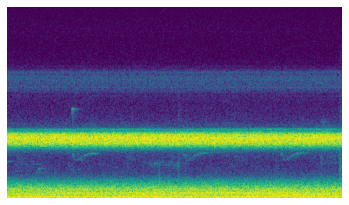

set3/00023757/20210818_STUDY/20210818T063147-0500_Rec_786.png
Detection:  Ovenbird
Confidence:  0.11040072
Detection:  Red-eyed Vireo
Confidence:  0.14155003
Detection:  Ovenbird
Confidence:  0.2259462


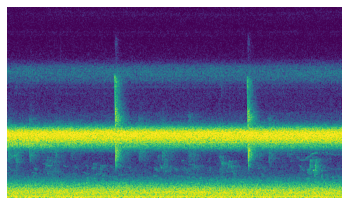

set3/00023757/20210819_STUDY/20210819T063147-0500_Rec_308.png
Detection:  Ovenbird
Confidence:  0.116455965
Detection:  Ovenbird
Confidence:  0.5218785
Detection:  Ovenbird
Confidence:  0.34936246


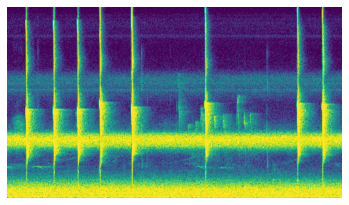

set3/00023757/20210818_STUDY/20210818T063147-0500_Rec_116.png
Detection:  Ruby-throated Hummingbird
Confidence:  0.101891786


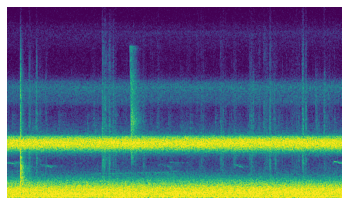

set3/00023757/20210813_STUDY/20210813T063140-0500_Rec_882.png
Detection:  Eastern Bluebird
Confidence:  0.38469
Detection:  Blue Jay
Confidence:  0.1847556
Detection:  Blue Jay
Confidence:  0.192788


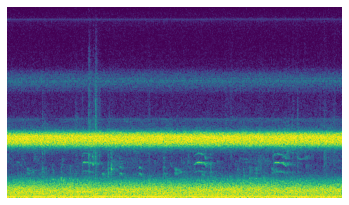

set3/00023771/20210817_STUDY/20210817T063147-0500_Rec_523.png
Detection:  No detection
Confidence:  1.0


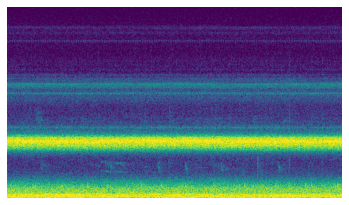

set3/00023757/20210813_STUDY/20210813T063140-0500_Rec_791.png
Detection:  Eastern Wood-Pewee
Confidence:  0.95647955


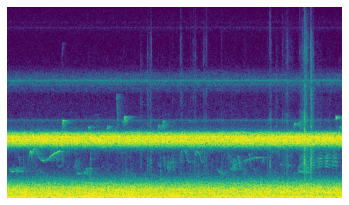

set3/00023757/20210813_STUDY/20210813T063140-0500_Rec_1177.png
Detection:  Blue Jay
Confidence:  0.51908416
Detection:  Blue Jay
Confidence:  0.5525044
Detection:  Eastern Wood-Pewee
Confidence:  0.33222347


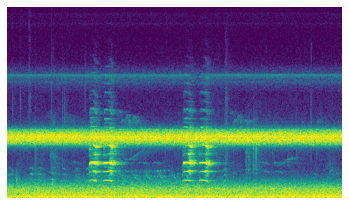

set3/00023757/20210819_STUDY/20210819T063147-0500_Rec_453.png
Detection:  Eastern Wood-Pewee
Confidence:  0.98360103


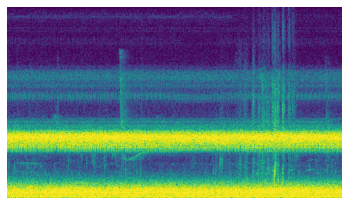

set3/00023795/20210813_STUDY/20210813T063140-0500_Rec_188.png
Detection:  Yellow-throated Vireo
Confidence:  0.34316793
Detection:  Scarlet Tanager
Confidence:  0.23774037
Detection:  Red-eyed Vireo
Confidence:  0.14710014


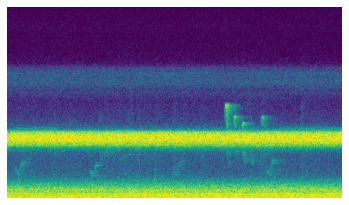

set3/00023757/20210819_STUDY/20210819T063147-0500_Rec_557.png
Detection:  No detection
Confidence:  1.0


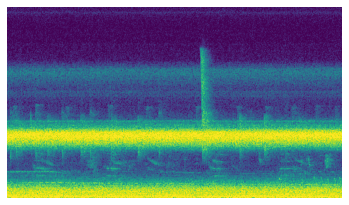

set3/00023757/20210818_STUDY/20210818T063147-0500_Rec_234.png
Detection:  Eastern Wood-Pewee
Confidence:  0.37569544


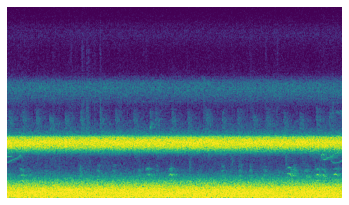

set3/00023795/20210813_STUDY/20210813T063140-0500_Rec_895.png
Detection:  Yellow-throated Vireo
Confidence:  0.6064729


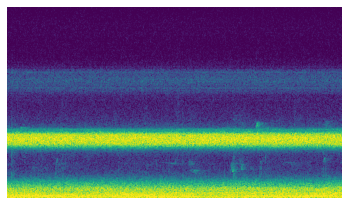

set3/00023757/20210819_STUDY/20210819T030852-0500_Rec_1278.png
Detection:  Red-eyed Vireo
Confidence:  0.28756627
Detection:  Red-eyed Vireo
Confidence:  0.22597836
Detection:  Eastern Wood-Pewee
Confidence:  0.11072329


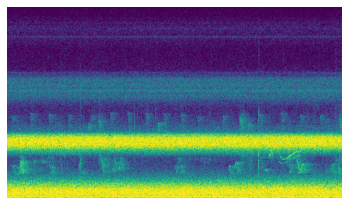

set3/00023757/20210813_STUDY/20210813T063140-0500_Rec_751.png
Detection:  Eastern Bluebird
Confidence:  0.75353986
Detection:  Eastern Wood-Pewee
Confidence:  0.16028725
Detection:  Eastern Bluebird
Confidence:  0.14250337
Detection:  Eastern Bluebird
Confidence:  0.39269355
Detection:  Baltimore Oriole
Confidence:  0.2425138


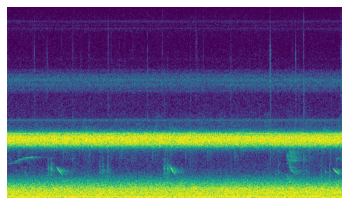

set3/00023757/20210813_STUDY/20210813T063140-0500_Rec_933.png
Detection:  Blue Jay
Confidence:  0.9094406
Detection:  Eastern Wood-Pewee
Confidence:  0.98959935
Detection:  Blue Jay
Confidence:  0.7835935


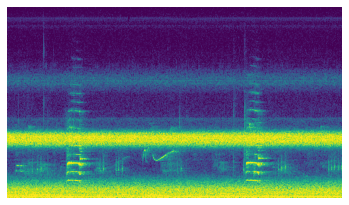

set3/00023757/20210820_STUDY/20210820T063147-0500_Rec_681.png
Detection:  Eastern Wood-Pewee
Confidence:  0.99493283
Detection:  Eastern Wood-Pewee
Confidence:  0.98472077
Detection:  Eastern Wood-Pewee
Confidence:  0.98955184


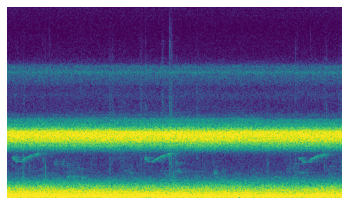

set3/00023757/20210818_STUDY/20210818T063147-0500_Rec_94.png
Detection:  Eastern Wood-Pewee
Confidence:  0.10682582
Detection:  Ruby-throated Hummingbird
Confidence:  0.60919976
Detection:  Ruby-throated Hummingbird
Confidence:  0.43354598


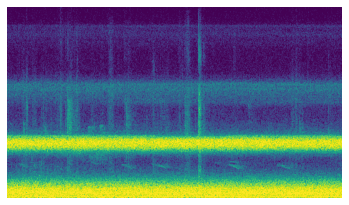

set3/00023757/20210819_STUDY/20210819T063147-0500_Rec_608.png
Detection:  Ovenbird
Confidence:  0.20215504
Detection:  Ovenbird
Confidence:  0.20997296


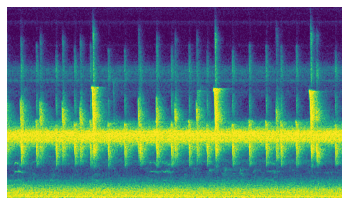

set3/00023757/20210817_STUDY/20210817T063147-0500_Rec_594.png
Detection:  Ovenbird
Confidence:  0.118209384
Detection:  American Robin
Confidence:  0.18523292


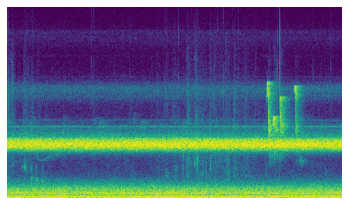

set3/00023757/20210813_STUDY/20210813T063140-0500_Rec_501.png
Detection:  Eastern Wood-Pewee
Confidence:  0.5507102
Detection:  Eastern Wood-Pewee
Confidence:  0.21051723
Detection:  Eastern Wood-Pewee
Confidence:  0.99064386


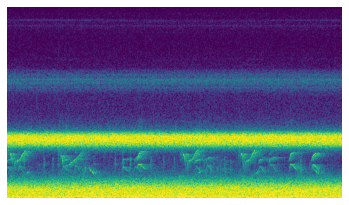

set3/00023757/20210813_STUDY/20210813T030845-0500_Rec_1339.png
Detection:  Baltimore Oriole
Confidence:  0.12397018


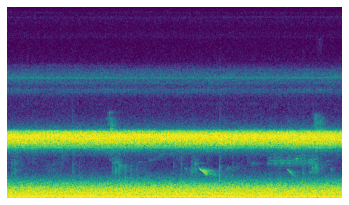

set3/00023757/20210818_STUDY/20210818T063147-0500_Rec_952.png
Detection:  Ruby-throated Hummingbird
Confidence:  0.99602973
Detection:  Ruby-throated Hummingbird
Confidence:  0.37981984
Detection:  Ruby-throated Hummingbird
Confidence:  0.85251874


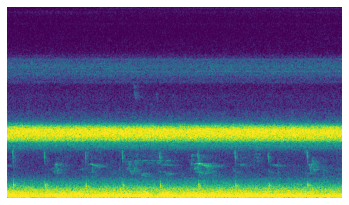

set3/00023757/20210820_STUDY/20210820T063147-0500_Rec_360.png
Detection:  Eastern Wood-Pewee
Confidence:  0.39876974


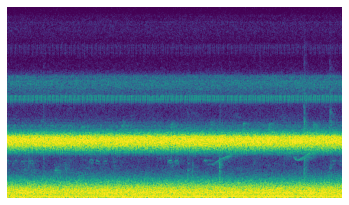

set3/00023757/20210819_STUDY/20210819T063147-0500_Rec_625.png
Detection:  Ovenbird
Confidence:  0.14267908


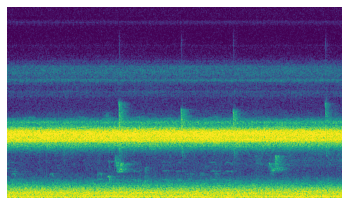

set3/00023757/20210819_STUDY/20210819T030852-0500_Rec_1340.png
Detection:  Ovenbird
Confidence:  0.11779644


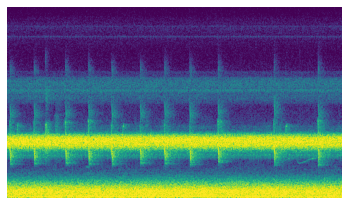

set3/00023757/20210820_STUDY/20210820T063147-0500_Rec_355.png
Detection:  Eastern Wood-Pewee
Confidence:  0.9643761


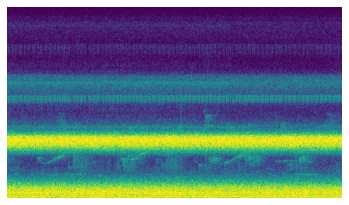

set3/00023757/20210818_STUDY/20210818T063147-0500_Rec_41.png
Detection:  Eastern Wood-Pewee
Confidence:  0.93215567
Detection:  Belted Kingfisher
Confidence:  0.939509


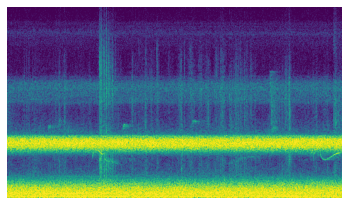

set3/00023757/20210818_STUDY/20210818T030852-0500_Rec_1013.png
Detection:  No detection
Confidence:  1.0


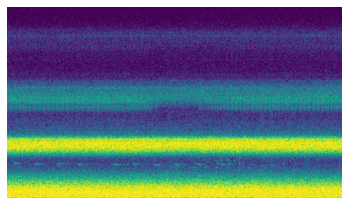

set3/00023757/20210818_STUDY/20210818T063147-0500_Rec_864.png
Detection:  Ovenbird
Confidence:  0.35171214
Detection:  Ovenbird
Confidence:  0.3845434
Detection:  Red-eyed Vireo
Confidence:  0.10582773


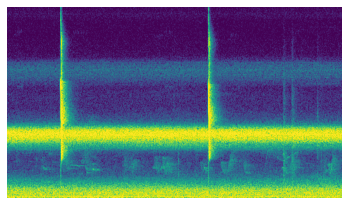

set3/00023757/20210818_STUDY/20210818T063147-0500_Rec_664.png
Detection:  Eastern Wood-Pewee
Confidence:  0.33155942
Detection:  Eastern Wood-Pewee
Confidence:  0.9200504
Detection:  Ovenbird
Confidence:  0.2049451


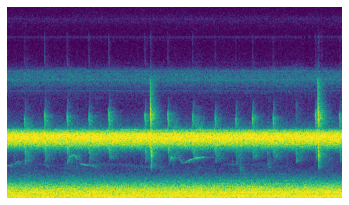

set3/00023757/20210813_STUDY/20210813T030845-0500_Rec_1194.png
Detection:  Red-headed Woodpecker
Confidence:  0.103471845
Detection:  Eastern Bluebird
Confidence:  0.7106596
Detection:  Baltimore Oriole
Confidence:  0.15198895


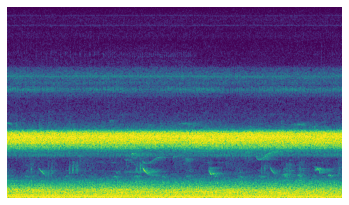

set3/00023795/20210818_STUDY/20210818T063146-0500_Rec_814.png
Detection:  Cedar Waxwing
Confidence:  0.20659553


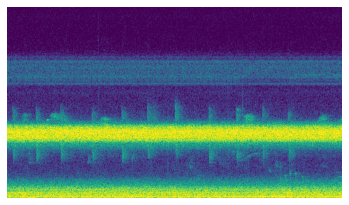

set3/00023757/20210820_STUDY/20210820T063147-0500_Rec_366.png
Detection:  Eastern Wood-Pewee
Confidence:  0.16323209
Detection:  Eastern Wood-Pewee
Confidence:  0.4891807


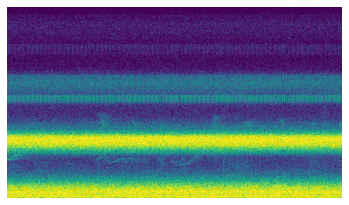

set3/00023795/20210818_STUDY/20210818T063146-0500_Rec_862.png
Detection:  Eastern Wood-Pewee
Confidence:  0.63163376
Detection:  Eastern Wood-Pewee
Confidence:  0.32748306
set3/00023757/20210820_STUDY/20210820T030852-0500_Rec_1332.png
Detection:  Common Grackle
Confidence:  0.10128838
Detection:  Red-headed Woodpecker
Confidence:  0.3670258
set3/00023795/20210813_STUDY/20210813T063140-0500_Rec_902.png
Detection:  No detection
Confidence:  1.0
set3/00023757/20210818_STUDY/20210818T063147-0500_Rec_339.png
Detection:  Hairy Woodpecker
Confidence:  0.13559796
set3/00023757/20210813_STUDY/20210813T030845-0500_Rec_1309.png
Detection:  Eastern Wood-Pewee
Confidence:  0.7912887
Detection:  Ruby-throated Hummingbird
Confidence:  0.10040858
Detection:  Ruby-throated Hummingbird
Confidence:  0.13673267
Detection:  Northern Cardinal
Confidence:  0.12546223
set3/00023757/20210818_STUDY/20210818T063147-0500_Rec_138.png
Detection:  Ovenbird
Confidence:  0.10926272
Detection:  Eastern Wood-Pewee
Confi

Detection:  Red-eyed Vireo
Confidence:  0.27957904
Detection:  Red-eyed Vireo
Confidence:  0.15881452
Detection:  Red-eyed Vireo
Confidence:  0.15481992
set3/00023757/20210819_STUDY/20210819T063147-0500_Rec_47.png
Detection:  No detection
Confidence:  1.0
set3/00023757/20210820_STUDY/20210820T063147-0500_Rec_176.png
Detection:  Ruby-throated Hummingbird
Confidence:  0.89012384
Detection:  Ruby-throated Hummingbird
Confidence:  0.84041244
Detection:  Ruby-throated Hummingbird
Confidence:  0.9140732
set3/00023757/20210818_STUDY/20210818T063147-0500_Rec_620.png
Detection:  Eastern Wood-Pewee
Confidence:  0.38480043
Detection:  Eastern Wood-Pewee
Confidence:  0.13102326
set3/00023757/20210818_STUDY/20210818T063147-0500_Rec_684.png
Detection:  Ovenbird
Confidence:  0.15023254
Detection:  Ovenbird
Confidence:  0.14120704
set3/00023795/20210818_STUDY/20210818T063146-0500_Rec_749.png
Detection:  Eastern Wood-Pewee
Confidence:  0.96446234
Detection:  Eastern Wood-Pewee
Confidence:  0.9642629
De

Detection:  Blue Jay
Confidence:  0.7429344
Detection:  Blue Jay
Confidence:  0.91834384
set3/00023757/20210820_STUDY/20210820T030852-0500_Rec_1173.png
Detection:  Yellow-throated Vireo
Confidence:  0.12886205
set3/00023757/20210818_STUDY/20210818T063147-0500_Rec_322.png
Detection:  No detection
Confidence:  1.0
set3/00023757/20210813_STUDY/20210813T063140-0500_Rec_760.png
Detection:  Eastern Wood-Pewee
Confidence:  0.78323966
Detection:  Eastern Wood-Pewee
Confidence:  0.12100031
set3/00023795/20210813_STUDY/20210813T063140-0500_Rec_1005.png
Detection:  Eastern Wood-Pewee
Confidence:  0.5821058
Detection:  Eastern Wood-Pewee
Confidence:  0.10018655
set3/00023757/20210819_STUDY/20210819T063147-0500_Rec_379.png
Detection:  Ovenbird
Confidence:  0.34782812
Detection:  Ovenbird
Confidence:  0.54615116
Detection:  Ovenbird
Confidence:  0.4023785
set3/00023757/20210813_STUDY/20210813T063140-0500_Rec_1240.png
Detection:  Ovenbird
Confidence:  0.23326083
Detection:  Ovenbird
Confidence:  0.62

Detection:  Eastern Wood-Pewee
Confidence:  0.8464346
Detection:  Red-bellied Woodpecker
Confidence:  0.43973923
set3/00023795/20210819_STUDY/20210819T063146-0500_Rec_344.png
Detection:  Eastern Wood-Pewee
Confidence:  0.99383485
Detection:  Eastern Wood-Pewee
Confidence:  0.98188883
set3/00023757/20210813_STUDY/20210813T063140-0500_Rec_987.png
Detection:  Blue Jay
Confidence:  0.9564064
Detection:  Red-eyed Vireo
Confidence:  0.33484215
set3/00023757/20210819_STUDY/20210819T063147-0500_Rec_122.png
Detection:  Ruby-throated Hummingbird
Confidence:  0.32889655
set3/00023757/20210813_STUDY/20210813T063140-0500_Rec_866.png
Detection:  No detection
Confidence:  1.0
set3/00023757/20210813_STUDY/20210813T063140-0500_Rec_823.png
Detection:  Eastern Wood-Pewee
Confidence:  0.99487525
set3/00023795/20210813_STUDY/20210813T063140-0500_Rec_404.png
Detection:  No detection
Confidence:  1.0
set3/00023795/20210818_STUDY/20210818T063146-0500_Rec_621.png
Detection:  Eastern Wood-Pewee
Confidence:  0.9

Detection:  Eastern Wood-Pewee
Confidence:  0.8634276
Detection:  Eastern Wood-Pewee
Confidence:  0.974241
Detection:  Eastern Wood-Pewee
Confidence:  0.8158729
set3/00023757/20210819_STUDY/20210819T063147-0500_Rec_265.png
Detection:  Red-eyed Vireo
Confidence:  0.3436971
Detection:  Yellow-throated Vireo
Confidence:  0.19237435
Detection:  Scarlet Tanager
Confidence:  0.112734675
Detection:  Red-eyed Vireo
Confidence:  0.23425153
set3/00023757/20210819_STUDY/20210819T063147-0500_Rec_452.png
Detection:  Yellow-throated Vireo
Confidence:  0.43336257
set3/00023757/20210818_STUDY/20210818T030852-0500_Rec_1240.png
Detection:  Eastern Wood-Pewee
Confidence:  0.25550535
Detection:  Black-capped Chickadee
Confidence:  0.44139454
set3/00023795/20210813_STUDY/20210813T063140-0500_Rec_143.png
Detection:  Eastern Wood-Pewee
Confidence:  0.9977204
Detection:  Eastern Wood-Pewee
Confidence:  0.99560285
set3/00023795/20210818_STUDY/20210818T063146-0500_Rec_399.png
Detection:  Red-bellied Woodpecker


Detection:  No detection
Confidence:  1.0
set3/00023757/20210818_STUDY/20210818T063147-0500_Rec_139.png
Detection:  Eastern Wood-Pewee
Confidence:  0.7211563
Detection:  Ovenbird
Confidence:  0.15370758
Detection:  Ovenbird
Confidence:  0.2812938
set3/00023757/20210813_STUDY/20210813T063140-0500_Rec_578.png
Detection:  Eastern Wood-Pewee
Confidence:  0.97961193
Detection:  Eastern Wood-Pewee
Confidence:  0.9798993
set3/00023757/20210813_STUDY/20210813T063140-0500_Rec_1161.png
Detection:  Blue Jay
Confidence:  0.42125028
Detection:  Eastern Wood-Pewee
Confidence:  0.86826986
Detection:  Blue Jay
Confidence:  0.2638705
set3/00023757/20210820_STUDY/20210820T030852-0500_Rec_1326.png
Detection:  Eastern Wood-Pewee
Confidence:  0.9792794
set3/00023757/20210813_STUDY/20210813T063140-0500_Rec_1141.png
Detection:  Blue Jay
Confidence:  0.1544419
Detection:  Blue Jay
Confidence:  0.5989732
Detection:  Blue Jay
Confidence:  0.14697796
set3/00023757/20210820_STUDY/20210820T063147-0500_Rec_678.png


set3/00023795/20210818_STUDY/20210818T063146-0500_Rec_466.png
Detection:  Eastern Wood-Pewee
Confidence:  0.7071759
Detection:  Eastern Wood-Pewee
Confidence:  0.9522179
set3/00023795/20210818_STUDY/20210818T063146-0500_Rec_430.png
Detection:  Eastern Wood-Pewee
Confidence:  0.99755377
Detection:  Eastern Wood-Pewee
Confidence:  0.5765103
Detection:  Eastern Wood-Pewee
Confidence:  0.95724565
set3/00023757/20210818_STUDY/20210818T063147-0500_Rec_964.png
Detection:  Eastern Wood-Pewee
Confidence:  0.92236704
Detection:  Eastern Wood-Pewee
Confidence:  0.84569216
set3/00023757/20210813_STUDY/20210813T030845-0500_Rec_1193.png
Detection:  Eastern Bluebird
Confidence:  0.6165097
Detection:  Eastern Bluebird
Confidence:  0.7518082
set3/00023757/20210819_STUDY/20210819T063147-0500_Rec_295.png
Detection:  No detection
Confidence:  1.0
set3/00023757/20210818_STUDY/20210818T063147-0500_Rec_288.png
Detection:  Eastern Wood-Pewee
Confidence:  0.84932554
set3/00023795/20210818_STUDY/20210818T063146

set3/00023757/20210818_STUDY/20210818T063147-0500_Rec_663.png
Detection:  Eastern Wood-Pewee
Confidence:  0.13953885
Detection:  Eastern Wood-Pewee
Confidence:  0.50103045
set3/00023795/20210818_STUDY/20210818T063146-0500_Rec_657.png
Detection:  Eastern Wood-Pewee
Confidence:  0.6330124
Detection:  Eastern Wood-Pewee
Confidence:  0.16765364
set3/00023757/20210813_STUDY/20210813T063140-0500_Rec_1016.png
Detection:  No detection
Confidence:  1.0
set3/00023757/20210818_STUDY/20210818T063147-0500_Rec_641.png
Detection:  White-breasted Nuthatch
Confidence:  0.8089636
Detection:  Eastern Wood-Pewee
Confidence:  0.21873648
Detection:  White-breasted Nuthatch
Confidence:  0.77636474
Detection:  White-breasted Nuthatch
Confidence:  0.8523765
set3/00023757/20210819_STUDY/20210819T063147-0500_Rec_89.png
Detection:  Ovenbird
Confidence:  0.13182896
Detection:  Eastern Wood-Pewee
Confidence:  0.94508666
set3/00023757/20210820_STUDY/20210820T063147-0500_Rec_54.png
Detection:  Ruby-throated Hummingbi

set3/00023757/20210820_STUDY/20210820T063147-0500_Rec_434.png
Detection:  Ruby-throated Hummingbird
Confidence:  0.15866421
set3/00023757/20210820_STUDY/20210820T063147-0500_Rec_104.png
Detection:  Ruby-throated Hummingbird
Confidence:  0.9631517
Detection:  Ruby-throated Hummingbird
Confidence:  0.7169305
set3/00023757/20210818_STUDY/20210818T063147-0500_Rec_530.png
Detection:  Ovenbird
Confidence:  0.12706877
Detection:  Ovenbird
Confidence:  0.6078998
Detection:  Red-eyed Vireo
Confidence:  0.1539441
Detection:  Ovenbird
Confidence:  0.12908265
Detection:  Yellow-throated Vireo
Confidence:  0.113667145
set3/00023757/20210818_STUDY/20210818T063147-0500_Rec_129.png
Detection:  No detection
Confidence:  1.0
set3/00023757/20210819_STUDY/20210819T030852-0500_Rec_1226.png
Detection:  Eastern Wood-Pewee
Confidence:  0.9638041
set3/00023757/20210820_STUDY/20210820T063147-0500_Rec_216.png
Detection:  Ruby-throated Hummingbird
Confidence:  0.42949906
Detection:  Indigo Bunting
Confidence:  0.

Detection:  Ovenbird
Confidence:  0.48294395
Detection:  Ovenbird
Confidence:  0.41782704
Detection:  Ovenbird
Confidence:  0.50018173
Detection:  Tennessee Warbler
Confidence:  0.12639204
set3/00023757/20210818_STUDY/20210818T063147-0500_Rec_502.png
Detection:  Ovenbird
Confidence:  0.13242732
Detection:  Tennessee Warbler
Confidence:  0.13163137
Detection:  Ovenbird
Confidence:  0.15341845
Detection:  Ovenbird
Confidence:  0.25428256
set3/00023757/20210818_STUDY/20210818T063147-0500_Rec_913.png
Detection:  Mourning Dove
Confidence:  0.2650854
Detection:  Red-eyed Vireo
Confidence:  0.10016212
set3/00023757/20210820_STUDY/20210820T063147-0500_Rec_408.png
Detection:  No detection
Confidence:  1.0
set3/00023757/20210820_STUDY/20210820T063147-0500_Rec_279.png
Detection:  Ruby-throated Hummingbird
Confidence:  0.15705113
Detection:  Ruby-throated Hummingbird
Confidence:  0.31745288
set3/00023757/20210813_STUDY/20210813T063140-0500_Rec_355.png
Detection:  Eastern Wood-Pewee
Confidence:  0.

Detection:  Eastern Wood-Pewee
Confidence:  0.68201935
Detection:  Eastern Wood-Pewee
Confidence:  0.59444934
set3/00023757/20210819_STUDY/20210819T030852-0500_Rec_1194.png
Detection:  Eastern Wood-Pewee
Confidence:  0.9887721
set3/00023757/20210819_STUDY/20210819T063147-0500_Rec_628.png
Detection:  American Redstart
Confidence:  0.14224203
Detection:  Tennessee Warbler
Confidence:  0.14180224
Detection:  Red-eyed Vireo
Confidence:  0.72922754
Detection:  Philadelphia Vireo
Confidence:  0.10478396
set3/00023795/20210818_STUDY/20210818T063146-0500_Rec_697.png
Detection:  Eastern Wood-Pewee
Confidence:  0.9765688
Detection:  Eastern Wood-Pewee
Confidence:  0.99444026
Detection:  Eastern Wood-Pewee
Confidence:  0.9979976
set3/00023757/20210817_STUDY/20210817T063147-0500_Rec_607.png
Detection:  Ovenbird
Confidence:  0.25423855
set3/00023757/20210820_STUDY/20210820T063147-0500_Rec_299.png
Detection:  Blue Jay
Confidence:  0.12722206
Detection:  Blue Jay
Confidence:  0.39660364
Detection:  B

set3/00023757/20210818_STUDY/20210818T063147-0500_Rec_456.png
Detection:  No detection
Confidence:  1.0
set3/00023757/20210818_STUDY/20210818T063147-0500_Rec_625.png
Detection:  Eastern Wood-Pewee
Confidence:  0.17812112
set3/00023795/20210813_STUDY/20210813T063140-0500_Rec_99.png
Detection:  Ovenbird
Confidence:  0.18976021
Detection:  Eastern Wood-Pewee
Confidence:  0.9386558
Detection:  Ovenbird
Confidence:  0.14312989
set3/00023757/20210817_STUDY/20210817T063147-0500_Rec_501.png
Detection:  White-breasted Nuthatch
Confidence:  0.16085131
set3/00023757/20210817_STUDY/20210817T063147-0500_Rec_777.png
Detection:  Downy Woodpecker
Confidence:  0.22177252
Detection:  Red-headed Woodpecker
Confidence:  0.17152923
Detection:  Hairy Woodpecker
Confidence:  0.102957115
Detection:  Ruby-throated Hummingbird
Confidence:  0.42633766
Detection:  Common Grackle
Confidence:  0.26782417
set3/00023757/20210818_STUDY/20210818T030852-0500_Rec_1245.png
Detection:  Eastern Wood-Pewee
Confidence:  0.945

Detection:  Red-bellied Woodpecker
Confidence:  0.12789512
set3/00023757/20210813_STUDY/20210813T063140-0500_Rec_627.png
Detection:  No detection
Confidence:  1.0
set3/00023757/20210818_STUDY/20210818T030852-0500_Rec_1243.png
Detection:  Killdeer
Confidence:  0.15160486
set3/00023757/20210813_STUDY/20210813T063140-0500_Rec_416.png
Detection:  Eastern Wood-Pewee
Confidence:  0.13092797
Detection:  Indigo Bunting
Confidence:  0.121101335
Detection:  Eastern Wood-Pewee
Confidence:  0.31893718
set3/00023795/20210813_STUDY/20210813T063140-0500_Rec_422.png
Detection:  No detection
Confidence:  1.0
set3/00023757/20210818_STUDY/20210818T030852-0500_Rec_1193.png
Detection:  Common Grackle
Confidence:  0.15752782
set3/00023757/20210820_STUDY/20210820T030852-0500_Rec_1135.png
Detection:  No detection
Confidence:  1.0
set3/00023757/20210820_STUDY/20210820T030852-0500_Rec_1283.png
Detection:  No detection
Confidence:  1.0
set3/00023757/20210813_STUDY/20210813T063140-0500_Rec_62.png
Detection:  Red-

Detection:  Ruby-throated Hummingbird
Confidence:  0.10290076
set3/00023757/20210819_STUDY/20210819T030852-0500_Rec_1236.png
Detection:  Red-winged Blackbird
Confidence:  0.25089556
Detection:  Eastern Wood-Pewee
Confidence:  0.74476683
set3/00023757/20210817_STUDY/20210817T063147-0500_Rec_745.png
Detection:  Yellow-throated Vireo
Confidence:  0.17784251
Detection:  Red-eyed Vireo
Confidence:  0.15083309
Detection:  Blue Jay
Confidence:  0.18890215
set3/00023795/20210813_STUDY/20210813T063140-0500_Rec_776.png
Detection:  Mourning Dove
Confidence:  0.26515904
set3/00023757/20210820_STUDY/20210820T030852-0500_Rec_1335.png
Detection:  No detection
Confidence:  1.0
set3/00023757/20210818_STUDY/20210818T063147-0500_Rec_711.png
Detection:  Ovenbird
Confidence:  0.27255982
Detection:  Ovenbird
Confidence:  0.51455945
Detection:  Ovenbird
Confidence:  0.1959904
set3/00023795/20210813_STUDY/20210813T063140-0500_Rec_893.png
Detection:  No detection
Confidence:  1.0
set3/00023795/20210813_STUDY/2

Detection:  Common Grackle
Confidence:  0.20656325
Detection:  Mourning Dove
Confidence:  0.15434623
set3/00023757/20210820_STUDY/20210820T030852-0500_Rec_1242.png
Detection:  Eastern Wood-Pewee
Confidence:  0.9749142
Detection:  Common Grackle
Confidence:  0.109977044
set3/00023757/20210818_STUDY/20210818T030852-0500_Rec_1225.png
Detection:  Cedar Waxwing
Confidence:  0.12530698
set3/00023757/20210813_STUDY/20210813T030845-0500_Rec_1162.png
Detection:  Eastern Wood-Pewee
Confidence:  0.9921794
Detection:  Eastern Wood-Pewee
Confidence:  0.87760884
set3/00023757/20210813_STUDY/20210813T063140-0500_Rec_656.png
Detection:  Eastern Bluebird
Confidence:  0.22893101
Detection:  Red-headed Woodpecker
Confidence:  0.12422029
Detection:  Eastern Bluebird
Confidence:  0.28818154
Detection:  Baltimore Oriole
Confidence:  0.2124522
set3/00023757/20210818_STUDY/20210818T063147-0500_Rec_932.png
Detection:  Red-eyed Vireo
Confidence:  0.1291241
Detection:  Eastern Wood-Pewee
Confidence:  0.21281497


Detection:  Ruby-throated Hummingbird
Confidence:  0.8120881
Detection:  Ruby-throated Hummingbird
Confidence:  0.9474375
Detection:  Ruby-throated Hummingbird
Confidence:  0.35977712
set3/00023757/20210819_STUDY/20210819T063147-0500_Rec_133.png
Detection:  No detection
Confidence:  1.0
set3/00023757/20210819_STUDY/20210819T063147-0500_Rec_76.png
Detection:  No detection
Confidence:  1.0
set3/00023757/20210819_STUDY/20210819T063147-0500_Rec_280.png
Detection:  Ovenbird
Confidence:  0.12190133
Detection:  American Redstart
Confidence:  0.10146972
Detection:  Ovenbird
Confidence:  0.15395756
set3/00023757/20210813_STUDY/20210813T063140-0500_Rec_1255.png
Detection:  No detection
Confidence:  1.0
set3/00023757/20210818_STUDY/20210818T063147-0500_Rec_9.png
Detection:  Red-eyed Vireo
Confidence:  0.2676717
Detection:  Red-eyed Vireo
Confidence:  0.15333247
set3/00023795/20210818_STUDY/20210818T063146-0500_Rec_445.png
Detection:  No detection
Confidence:  1.0
set3/00023757/20210813_STUDY/2021

Confidence:  0.26988268
set3/00023795/20210813_STUDY/20210813T063140-0500_Rec_231.png
Detection:  Mourning Dove
Confidence:  0.20906872
Detection:  Eastern Wood-Pewee
Confidence:  0.99216825
Detection:  Eastern Wood-Pewee
Confidence:  0.9954407
set3/00023757/20210813_STUDY/20210813T030845-0500_Rec_1182.png
Detection:  Eastern Bluebird
Confidence:  0.7558254
Detection:  Eastern Wood-Pewee
Confidence:  0.65647835
Detection:  Eastern Wood-Pewee
Confidence:  0.9623856
Detection:  Eastern Wood-Pewee
Confidence:  0.95859945
set3/00023757/20210820_STUDY/20210820T030852-0500_Rec_1331.png
Detection:  No detection
Confidence:  1.0
set3/00023795/20210818_STUDY/20210818T063146-0500_Rec_464.png
Detection:  No detection
Confidence:  1.0
set3/00023757/20210819_STUDY/20210819T063147-0500_Rec_279.png
Detection:  No detection
Confidence:  1.0
set3/00023757/20210820_STUDY/20210820T030852-0500_Rec_1110.png
Detection:  American Goldfinch
Confidence:  0.28997463
set3/00023757/20210813_STUDY/20210813T063140-

Confidence:  0.20462132
Detection:  Hairy Woodpecker
Confidence:  0.95012414
set3/00023757/20210820_STUDY/20210820T063147-0500_Rec_265.png
Detection:  Ruby-throated Hummingbird
Confidence:  0.59300244
Detection:  Ruby-throated Hummingbird
Confidence:  0.28400257
Detection:  Ruby-throated Hummingbird
Confidence:  0.7584842
set3/00023757/20210813_STUDY/20210813T063140-0500_Rec_120.png
Detection:  Downy Woodpecker
Confidence:  0.1819084
Detection:  Red-headed Woodpecker
Confidence:  0.12938799
Detection:  Red-headed Woodpecker
Confidence:  0.2705538
Detection:  Downy Woodpecker
Confidence:  0.20173879
Detection:  Red-bellied Woodpecker
Confidence:  0.1278419
Detection:  Baltimore Oriole
Confidence:  0.2262271
Detection:  Red-headed Woodpecker
Confidence:  0.13529512
set3/00023795/20210818_STUDY/20210818T063146-0500_Rec_407.png
Detection:  Ruby-throated Hummingbird
Confidence:  0.1397493
Detection:  Ruby-throated Hummingbird
Confidence:  0.14813174
set3/00023757/20210818_STUDY/20210818T063

Detection:  Eastern Wood-Pewee
Confidence:  0.7243243
Detection:  Eastern Wood-Pewee
Confidence:  0.16686356
Detection:  Eastern Wood-Pewee
Confidence:  0.6177512
set3/00023757/20210819_STUDY/20210819T063147-0500_Rec_186.png
Detection:  Belted Kingfisher
Confidence:  0.34440127
set3/00023757/20210820_STUDY/20210820T063147-0500_Rec_704.png
Detection:  Eastern Wood-Pewee
Confidence:  0.99306893
Detection:  Eastern Wood-Pewee
Confidence:  0.99977463
Detection:  Northern Flicker
Confidence:  0.106332876
set3/00023795/20210818_STUDY/20210818T063146-0500_Rec_695.png
Detection:  Eastern Wood-Pewee
Confidence:  0.22091013
Detection:  Red-headed Woodpecker
Confidence:  0.11224888
Detection:  Eastern Wood-Pewee
Confidence:  0.9974884
set3/00023757/20210813_STUDY/20210813T063140-0500_Rec_417.png
Detection:  Eastern Wood-Pewee
Confidence:  0.45561948
Detection:  Eastern Wood-Pewee
Confidence:  0.11758049
set3/00023757/20210813_STUDY/20210813T063140-0500_Rec_631.png
Detection:  Eastern Bluebird
Con

Detection:  Eastern Wood-Pewee
Confidence:  0.4335079
set3/00023757/20210820_STUDY/20210820T063147-0500_Rec_613.png
Detection:  Red-eyed Vireo
Confidence:  0.29668516
set3/00023757/20210813_STUDY/20210813T063140-0500_Rec_403.png
Detection:  Eastern Wood-Pewee
Confidence:  0.16387637
Detection:  Veery
Confidence:  0.10061988
Detection:  Veery
Confidence:  0.2308805
Detection:  Eastern Wood-Pewee
Confidence:  0.8854916
set3/00023795/20210813_STUDY/20210813T063140-0500_Rec_838.png
Detection:  No detection
Confidence:  1.0
set3/00023757/20210819_STUDY/20210819T063147-0500_Rec_53.png
Detection:  No detection
Confidence:  1.0
set3/00023757/20210820_STUDY/20210820T063147-0500_Rec_575.png
Detection:  Yellow-throated Vireo
Confidence:  0.17585175
Detection:  Red-eyed Vireo
Confidence:  0.11219059
set3/00023757/20210813_STUDY/20210813T063140-0500_Rec_899.png
Detection:  Northern Flicker
Confidence:  0.14693281
set3/00023757/20210819_STUDY/20210819T063147-0500_Rec_741.png
Detection:  White-breast

Detection:  Blue Jay
Confidence:  0.13444927
Detection:  Ovenbird
Confidence:  0.106285
set3/00023795/20210818_STUDY/20210818T063146-0500_Rec_853.png
Detection:  Eastern Wood-Pewee
Confidence:  0.95608974
set3/00023757/20210813_STUDY/20210813T063140-0500_Rec_30.png
Detection:  Eastern Wood-Pewee
Confidence:  0.96044296
Detection:  Eastern Bluebird
Confidence:  0.15163699
Detection:  American Robin
Confidence:  0.10944903
set3/00023757/20210813_STUDY/20210813T063140-0500_Rec_37.png
Detection:  Eastern Wood-Pewee
Confidence:  0.2849741
Detection:  Eastern Wood-Pewee
Confidence:  0.99764234
set3/00023757/20210818_STUDY/20210818T030852-0500_Rec_882.png
Detection:  No detection
Confidence:  1.0
set3/00023757/20210818_STUDY/20210818T063147-0500_Rec_799.png
Detection:  Ovenbird
Confidence:  0.35570556
Detection:  Eastern Wood-Pewee
Confidence:  0.62763125
set3/00023757/20210813_STUDY/20210813T063140-0500_Rec_918.png
Detection:  Ruby-throated Hummingbird
Confidence:  0.32922772
set3/00023795/2

Detection:  Blue Jay
Confidence:  0.81155413
Detection:  Blue Jay
Confidence:  0.19115561
set3/00023757/20210813_STUDY/20210813T063140-0500_Rec_288.png
Detection:  Eastern Bluebird
Confidence:  0.27722177
Detection:  Indigo Bunting
Confidence:  0.10960585
Detection:  Eastern Bluebird
Confidence:  0.12698989
Detection:  Yellow-throated Vireo
Confidence:  0.10052661
set3/00023757/20210817_STUDY/20210817T063147-0500_Rec_986.png
Detection:  American Robin
Confidence:  0.32656246
set3/00023757/20210813_STUDY/20210813T030845-0500_Rec_1199.png
Detection:  Red-headed Woodpecker
Confidence:  0.16185227
Detection:  Eastern Wood-Pewee
Confidence:  0.28029913
set3/00023795/20210813_STUDY/20210813T063140-0500_Rec_111.png
Detection:  Eastern Wood-Pewee
Confidence:  0.14120917
Detection:  Ovenbird
Confidence:  0.13951877
Detection:  Eastern Wood-Pewee
Confidence:  0.5993078
set3/00023757/20210813_STUDY/20210813T063140-0500_Rec_696.png
Detection:  Black-capped Chickadee
Confidence:  0.8633594
Detectio

Detection:  Ovenbird
Confidence:  0.15639123
Detection:  Ovenbird
Confidence:  0.11049891
Detection:  Ovenbird
Confidence:  0.18626831
set3/00023757/20210818_STUDY/20210818T063147-0500_Rec_624.png
Detection:  No detection
Confidence:  1.0
set3/00023757/20210818_STUDY/20210818T063147-0500_Rec_665.png
Detection:  No detection
Confidence:  1.0
set3/00023795/20210813_STUDY/20210813T063140-0500_Rec_410.png
Detection:  No detection
Confidence:  1.0
set3/00023757/20210813_STUDY/20210813T063140-0500_Rec_468.png
Detection:  Eastern Wood-Pewee
Confidence:  0.4759491
Detection:  Eastern Wood-Pewee
Confidence:  0.32950684
Detection:  Eastern Wood-Pewee
Confidence:  0.14219749
set3/00023795/20210818_STUDY/20210818T063146-0500_Rec_593.png
Detection:  No detection
Confidence:  1.0
set3/00023757/20210819_STUDY/20210819T063147-0500_Rec_146.png
Detection:  Red-eyed Vireo
Confidence:  0.13402893
Detection:  Eastern Wood-Pewee
Confidence:  0.96328616
Detection:  Red-eyed Vireo
Confidence:  0.42457193
set3

Confidence:  0.25909555
Detection:  Ruby-throated Hummingbird
Confidence:  0.1614884
set3/00023757/20210818_STUDY/20210818T063147-0500_Rec_210.png
Detection:  No detection
Confidence:  1.0
set3/00023795/20210818_STUDY/20210818T063146-0500_Rec_742.png
Detection:  Eastern Wood-Pewee
Confidence:  0.9341458
set3/00023757/20210818_STUDY/20210818T063147-0500_Rec_515.png
Detection:  Ovenbird
Confidence:  0.12756574
Detection:  Ovenbird
Confidence:  0.17304549
Detection:  Red-eyed Vireo
Confidence:  0.104429655
Detection:  Tennessee Warbler
Confidence:  0.17538431
set3/00023757/20210820_STUDY/20210820T030852-0500_Rec_1267.png
Detection:  Eastern Wood-Pewee
Confidence:  0.7095344
set3/00023795/20210819_STUDY/20210819T063146-0500_Rec_205.png
Detection:  Eastern Wood-Pewee
Confidence:  0.5215664
Detection:  Eastern Wood-Pewee
Confidence:  0.64596945
set3/00023795/20210813_STUDY/20210813T063140-0500_Rec_853.png
Detection:  No detection
Confidence:  1.0
set3/00023757/20210820_STUDY/20210820T063147-

Detection:  Blue Jay
Confidence:  0.13320725
Detection:  Blue Jay
Confidence:  0.349225
set3/00023795/20210818_STUDY/20210818T063146-0500_Rec_754.png
Detection:  Eastern Wood-Pewee
Confidence:  0.6162616
Detection:  Eastern Wood-Pewee
Confidence:  0.9864406
Detection:  Eastern Wood-Pewee
Confidence:  0.7227886
set3/00023757/20210813_STUDY/20210813T030845-0500_Rec_1322.png
Detection:  No detection
Confidence:  1.0
set3/00023757/20210820_STUDY/20210820T063147-0500_Rec_758.png
Detection:  Eastern Wood-Pewee
Confidence:  0.9214755
set3/00023757/20210813_STUDY/20210813T063140-0500_Rec_1259.png
Detection:  Blue Jay
Confidence:  0.12287176
set3/00023757/20210819_STUDY/20210819T063147-0500_Rec_124.png
Detection:  Eastern Wood-Pewee
Confidence:  0.77801067
set3/00023757/20210819_STUDY/20210819T063147-0500_Rec_426.png
Detection:  No detection
Confidence:  1.0
set3/00023757/20210813_STUDY/20210813T063140-0500_Rec_852.png
Detection:  Blue Jay
Confidence:  0.22579014
Detection:  Blue Jay
Confidence

Detection:  Scarlet Tanager
Confidence:  0.16481583
Detection:  Red-eyed Vireo
Confidence:  0.14521942
Detection:  Red-eyed Vireo
Confidence:  0.22257018
set3/00023795/20210813_STUDY/20210813T063140-0500_Rec_343.png
Detection:  Yellow-throated Vireo
Confidence:  0.15447953
Detection:  Scarlet Tanager
Confidence:  0.13562782
Detection:  Yellow-throated Vireo
Confidence:  0.11362702
set3/00023757/20210819_STUDY/20210819T063147-0500_Rec_501.png
Detection:  Red-eyed Vireo
Confidence:  0.17770225
set3/00023757/20210819_STUDY/20210819T063147-0500_Rec_788.png
Detection:  Green Heron
Confidence:  0.10605614
set3/00023757/20210813_STUDY/20210813T063140-0500_Rec_705.png
Detection:  Eastern Bluebird
Confidence:  0.21896207
Detection:  Eastern Bluebird
Confidence:  0.61909664
Detection:  Eastern Wood-Pewee
Confidence:  0.70522076
Detection:  Ruby-throated Hummingbird
Confidence:  0.26676536
set3/00023757/20210813_STUDY/20210813T030845-0500_Rec_1304.png
Detection:  Red-eyed Vireo
Confidence:  0.477

Detection:  American Redstart
Confidence:  0.18899865
Detection:  American Redstart
Confidence:  0.33588326
Detection:  American Redstart
Confidence:  0.5635953
set3/00023795/20210813_STUDY/20210813T063140-0500_Rec_134.png
Detection:  Northern Cardinal
Confidence:  0.6908384
Detection:  Eastern Wood-Pewee
Confidence:  0.43966445
Detection:  Northern Cardinal
Confidence:  0.1796168
Detection:  Eastern Wood-Pewee
Confidence:  0.9787283
set3/00023795/20210813_STUDY/20210813T063140-0500_Rec_760.png
Detection:  Eastern Wood-Pewee
Confidence:  0.63473105
set3/00023757/20210813_STUDY/20210813T063140-0500_Rec_1041.png
Detection:  Field Sparrow
Confidence:  0.42680243
Detection:  Green Heron
Confidence:  0.41891974
set3/00023757/20210817_STUDY/20210817T063147-0500_Rec_627.png
Detection:  Eastern Wood-Pewee
Confidence:  0.7473899
Detection:  Eastern Wood-Pewee
Confidence:  0.992808
set3/00023757/20210817_STUDY/20210817T063147-0500_Rec_600.png
Detection:  Ovenbird
Confidence:  0.13030052
set3/000

Detection:  Blue Jay
Confidence:  0.41198388
Detection:  Eastern Wood-Pewee
Confidence:  0.7984022
Detection:  Eastern Wood-Pewee
Confidence:  0.28147215
set3/00023757/20210818_STUDY/20210818T030852-0500_Rec_1211.png
Detection:  No detection
Confidence:  1.0
set3/00023795/20210813_STUDY/20210813T063140-0500_Rec_161.png
Detection:  No detection
Confidence:  1.0
set3/00023757/20210813_STUDY/20210813T063140-0500_Rec_1088.png
Detection:  Blue Jay
Confidence:  0.48440695
set3/00023795/20210818_STUDY/20210818T063146-0500_Rec_571.png
Detection:  No detection
Confidence:  1.0
set3/00023757/20210819_STUDY/20210819T030852-0500_Rec_1142.png
Detection:  No detection
Confidence:  1.0
set3/00023757/20210819_STUDY/20210819T063147-0500_Rec_429.png
Detection:  Ruby-throated Hummingbird
Confidence:  0.10410414
set3/00023795/20210818_STUDY/20210818T063146-0500_Rec_654.png
Detection:  Eastern Wood-Pewee
Confidence:  0.19741982
Detection:  Eastern Wood-Pewee
Confidence:  0.91223603
set3/00023757/20210813_S

Detection:  Red-eyed Vireo
Confidence:  0.14021339
set3/00023757/20210818_STUDY/20210818T063147-0500_Rec_781.png
Detection:  Yellow-throated Vireo
Confidence:  0.24351203
Detection:  Red-eyed Vireo
Confidence:  0.17348391
Detection:  Eastern Wood-Pewee
Confidence:  0.25216737
set3/00023757/20210817_STUDY/20210817T063147-0500_Rec_577.png
Detection:  White-breasted Nuthatch
Confidence:  0.9345651
Detection:  White-breasted Nuthatch
Confidence:  0.40136382
set3/00023795/20210818_STUDY/20210818T063146-0500_Rec_480.png
Detection:  Blue Jay
Confidence:  0.14089704
Detection:  Red-bellied Woodpecker
Confidence:  0.101277255
Detection:  Eastern Wood-Pewee
Confidence:  0.2037005
Detection:  Blue Jay
Confidence:  0.16504233
set3/00023757/20210818_STUDY/20210818T063147-0500_Rec_376.png
Detection:  Ruby-throated Hummingbird
Confidence:  0.7221281
set3/00023757/20210819_STUDY/20210819T063147-0500_Rec_751.png
Detection:  Red-headed Woodpecker
Confidence:  0.15278654
Detection:  Green Heron
Confidenc

Detection:  Ruby-throated Hummingbird
Confidence:  0.7952559
Detection:  Ruby-throated Hummingbird
Confidence:  0.16966942
Detection:  Northern Flicker
Confidence:  0.16763543
Detection:  Northern Flicker
Confidence:  0.24558043
Detection:  Ruby-throated Hummingbird
Confidence:  0.13978824
set3/00023757/20210817_STUDY/20210817T063147-0500_Rec_496.png
Detection:  Blue Jay
Confidence:  0.21993874
set3/00023795/20210818_STUDY/20210818T063146-0500_Rec_429.png
Detection:  Eastern Wood-Pewee
Confidence:  0.9975889
set3/00023795/20210818_STUDY/20210818T063146-0500_Rec_638.png
Detection:  Blue Jay
Confidence:  0.1319987
Detection:  Eastern Wood-Pewee
Confidence:  0.49187434
Detection:  Blue Jay
Confidence:  0.1370531
Detection:  Blue Jay
Confidence:  0.2490361
set3/00023757/20210818_STUDY/20210818T063147-0500_Rec_645.png
Detection:  Eastern Wood-Pewee
Confidence:  0.6247685
Detection:  Ovenbird
Confidence:  0.10308488
Detection:  Eastern Wood-Pewee
Confidence:  0.53762716
Detection:  Ovenbird


Detection:  No detection
Confidence:  1.0
set3/00023757/20210813_STUDY/20210813T063140-0500_Rec_1097.png
Detection:  Blue Jay
Confidence:  0.12930031
Detection:  Blue Jay
Confidence:  0.11813768
set3/00023757/20210817_STUDY/20210817T063147-0500_Rec_785.png
Detection:  Belted Kingfisher
Confidence:  0.11961625
Detection:  Red-headed Woodpecker
Confidence:  0.10567391
set3/00023757/20210819_STUDY/20210819T030852-0500_Rec_1258.png
Detection:  Ovenbird
Confidence:  0.14822632
Detection:  Ovenbird
Confidence:  0.13443038
Detection:  Ovenbird
Confidence:  0.14053993
set3/00023757/20210817_STUDY/20210817T063147-0500_Rec_952.png
Detection:  Ruby-throated Hummingbird
Confidence:  0.7212148
set3/00023757/20210820_STUDY/20210820T063147-0500_Rec_568.png
Detection:  Blue Jay
Confidence:  0.42937842
Detection:  Red-eyed Vireo
Confidence:  0.35452172
Detection:  Yellow-throated Vireo
Confidence:  0.12708908
Detection:  Blue Jay
Confidence:  0.36341065
set3/00023795/20210818_STUDY/20210818T063146-0500

Detection:  Eastern Wood-Pewee
Confidence:  0.29838237
set3/00023757/20210818_STUDY/20210818T063147-0500_Rec_194.png
Detection:  Black-capped Chickadee
Confidence:  0.55144656
Detection:  Golden-winged Warbler
Confidence:  0.1491966
Detection:  Field Sparrow
Confidence:  0.1303961
Detection:  Black-capped Chickadee
Confidence:  0.18158624
set3/00023757/20210820_STUDY/20210820T063147-0500_Rec_508.png
Detection:  No detection
Confidence:  1.0
set3/00023757/20210820_STUDY/20210820T030852-0500_Rec_1248.png
Detection:  American Goldfinch
Confidence:  0.44590542
Detection:  Eastern Wood-Pewee
Confidence:  0.9602798
set3/00023757/20210818_STUDY/20210818T063147-0500_Rec_885.png
Detection:  White-breasted Nuthatch
Confidence:  0.17649758
Detection:  Ovenbird
Confidence:  0.21880762
Detection:  White-breasted Nuthatch
Confidence:  0.66921496
set3/00023757/20210813_STUDY/20210813T063140-0500_Rec_446.png
Detection:  Eastern Wood-Pewee
Confidence:  0.28300846
Detection:  Eastern Wood-Pewee
Confiden

Detection:  Ruby-throated Hummingbird
Confidence:  0.10071117
Detection:  Ruby-throated Hummingbird
Confidence:  0.355566
set3/00023757/20210820_STUDY/20210820T030852-0500_Rec_998.png
Detection:  No detection
Confidence:  1.0
set3/00023757/20210820_STUDY/20210820T063147-0500_Rec_12.png
Detection:  No detection
Confidence:  1.0
set3/00023757/20210819_STUDY/20210819T063147-0500_Rec_482.png
Detection:  No detection
Confidence:  1.0
set3/00023757/20210813_STUDY/20210813T063140-0500_Rec_683.png
Detection:  Blue Jay
Confidence:  0.108048275
Detection:  Northern Cardinal
Confidence:  0.349622
Detection:  Black-capped Chickadee
Confidence:  0.108492166
set3/00023757/20210818_STUDY/20210818T030852-0500_Rec_894.png
Detection:  No detection
Confidence:  1.0
set3/00023757/20210818_STUDY/20210818T063147-0500_Rec_385.png
Detection:  Eastern Wood-Pewee
Confidence:  0.93502325
set3/00023757/20210820_STUDY/20210820T030852-0500_Rec_1061.png
Detection:  Killdeer
Confidence:  0.11665007
set3/00023795/2021

Detection:  Ruby-throated Hummingbird
Confidence:  0.1045049
set3/00023757/20210819_STUDY/20210819T030852-0500_Rec_1313.png
Detection:  No detection
Confidence:  1.0
set3/00023795/20210818_STUDY/20210818T063146-0500_Rec_387.png
Detection:  Ruby-throated Hummingbird
Confidence:  0.43936002
Detection:  Ruby-throated Hummingbird
Confidence:  0.17458452
Detection:  Eastern Wood-Pewee
Confidence:  0.10106744
set3/00023757/20210813_STUDY/20210813T063140-0500_Rec_272.png
Detection:  Eastern Wood-Pewee
Confidence:  0.55507743
Detection:  Baltimore Oriole
Confidence:  0.17731784
Detection:  Eastern Wood-Pewee
Confidence:  0.17831163
set3/00023757/20210818_STUDY/20210818T063147-0500_Rec_374.png
Detection:  No detection
Confidence:  1.0
set3/00023757/20210819_STUDY/20210819T063147-0500_Rec_309.png
Detection:  Ovenbird
Confidence:  0.16853257
Detection:  Ovenbird
Confidence:  0.10336324
set3/00023795/20210819_STUDY/20210819T063146-0500_Rec_368.png
Detection:  Eastern Wood-Pewee
Confidence:  0.9931

Detection:  Belted Kingfisher
Confidence:  0.90731204
Detection:  Ruby-throated Hummingbird
Confidence:  0.15300791
set3/00023795/20210818_STUDY/20210818T063146-0500_Rec_496.png
Detection:  Black-capped Chickadee
Confidence:  0.42492446
Detection:  Black-capped Chickadee
Confidence:  0.10919981
set3/00023757/20210813_STUDY/20210813T063140-0500_Rec_280.png
Detection:  Baltimore Oriole
Confidence:  0.14505085
Detection:  Indigo Bunting
Confidence:  0.107666984
set3/00023757/20210818_STUDY/20210818T030852-0500_Rec_1332.png
Detection:  Ovenbird
Confidence:  0.15042257
Detection:  Ovenbird
Confidence:  0.21212189
Detection:  Eastern Wood-Pewee
Confidence:  0.5495425
set3/00023757/20210818_STUDY/20210818T063147-0500_Rec_847.png
Detection:  White-breasted Nuthatch
Confidence:  0.27906045
Detection:  White-breasted Nuthatch
Confidence:  0.85041934
set3/00023757/20210813_STUDY/20210813T063140-0500_Rec_52.png
Detection:  Eastern Wood-Pewee
Confidence:  0.17467046
Detection:  Eastern Wood-Pewee
C

Detection:  No detection
Confidence:  1.0
set3/00023795/20210818_STUDY/20210818T063146-0500_Rec_436.png
Detection:  Eastern Wood-Pewee
Confidence:  0.9980598
Detection:  Eastern Wood-Pewee
Confidence:  0.9966228
Detection:  Red-bellied Woodpecker
Confidence:  0.10372072
set3/00023757/20210819_STUDY/20210819T063147-0500_Rec_737.png
Detection:  Red-headed Woodpecker
Confidence:  0.2922651
Detection:  Green Heron
Confidence:  0.15004387
Detection:  Downy Woodpecker
Confidence:  0.1318969
Detection:  Red-headed Woodpecker
Confidence:  0.4011883
Detection:  Green Heron
Confidence:  0.1732663
Detection:  Green Heron
Confidence:  0.157369
set3/00023757/20210813_STUDY/20210813T030845-0500_Rec_1330.png
Detection:  No detection
Confidence:  1.0
set3/00023757/20210813_STUDY/20210813T063140-0500_Rec_535.png
Detection:  Eastern Wood-Pewee
Confidence:  0.13441531
set3/00023757/20210819_STUDY/20210819T030852-0500_Rec_1351.png
Detection:  Red-eyed Vireo
Confidence:  0.13764581
Detection:  Red-eyed Vir

Detection:  Blue Jay
Confidence:  0.37230724
Detection:  Blue Jay
Confidence:  0.21718115
set3/00023757/20210813_STUDY/20210813T030845-0500_Rec_1184.png
Detection:  Eastern Wood-Pewee
Confidence:  0.95996463
Detection:  Eastern Bluebird
Confidence:  0.9971455
set3/00023757/20210813_STUDY/20210813T063140-0500_Rec_1191.png
Detection:  Eastern Wood-Pewee
Confidence:  0.6308862
Detection:  Ruby-throated Hummingbird
Confidence:  0.12725243
set3/00023757/20210818_STUDY/20210818T063147-0500_Rec_382.png
Detection:  Eastern Wood-Pewee
Confidence:  0.97802645
set3/00023757/20210818_STUDY/20210818T030852-0500_Rec_1038.png
Detection:  No detection
Confidence:  1.0
set3/00023757/20210820_STUDY/20210820T030852-0500_Rec_1022.png
Detection:  No detection
Confidence:  1.0
set3/00023757/20210818_STUDY/20210818T030852-0500_Rec_1008.png
Detection:  Red-winged Blackbird
Confidence:  0.1905303
set3/00023757/20210820_STUDY/20210820T063147-0500_Rec_547.png
Detection:  No detection
Confidence:  1.0
set3/000237

Detection:  Eastern Bluebird
Confidence:  0.73091084
Detection:  Eastern Wood-Pewee
Confidence:  0.120720826
Detection:  Eastern Wood-Pewee
Confidence:  0.23324275
set3/00023795/20210818_STUDY/20210818T063146-0500_Rec_787.png
Detection:  Eastern Wood-Pewee
Confidence:  0.97475636
Detection:  Eastern Phoebe
Confidence:  0.2808544
Detection:  Eastern Wood-Pewee
Confidence:  0.20863803
set3/00023757/20210813_STUDY/20210813T063140-0500_Rec_1068.png
Detection:  Red-eyed Vireo
Confidence:  0.18461
Detection:  Scarlet Tanager
Confidence:  0.10246763
Detection:  Red-eyed Vireo
Confidence:  0.10557413
set3/00023757/20210818_STUDY/20210818T063147-0500_Rec_941.png
Detection:  Belted Kingfisher
Confidence:  0.4674938
Detection:  Red-headed Woodpecker
Confidence:  0.10487607
set3/00023757/20210820_STUDY/20210820T063147-0500_Rec_706.png
Detection:  Eastern Wood-Pewee
Confidence:  0.9899838
Detection:  Eastern Wood-Pewee
Confidence:  0.9972211
Detection:  Eastern Wood-Pewee
Confidence:  0.9383604
set

Detection:  Eastern Wood-Pewee
Confidence:  0.25113523
Detection:  Scarlet Tanager
Confidence:  0.10633824
Detection:  Red-eyed Vireo
Confidence:  0.103917785
set3/00023757/20210819_STUDY/20210819T030852-0500_Rec_1316.png
Detection:  No detection
Confidence:  1.0
set3/00023757/20210820_STUDY/20210820T063147-0500_Rec_579.png
Detection:  Scarlet Tanager
Confidence:  0.11351117
Detection:  White-breasted Nuthatch
Confidence:  0.1941941
Detection:  Red-eyed Vireo
Confidence:  0.4753067
set3/00023757/20210820_STUDY/20210820T063147-0500_Rec_394.png
Detection:  Red-eyed Vireo
Confidence:  0.12656805
set3/00023757/20210818_STUDY/20210818T063147-0500_Rec_149.png
Detection:  Ovenbird
Confidence:  0.34462833
Detection:  Ovenbird
Confidence:  0.35848415
Detection:  Ovenbird
Confidence:  0.33973873
Detection:  Eastern Wood-Pewee
Confidence:  0.15470938
set3/00023757/20210813_STUDY/20210813T030845-0500_Rec_1310.png
Detection:  Downy Woodpecker
Confidence:  0.54424435
Detection:  Red-headed Woodpecke

Detection:  Eastern Wood-Pewee
Confidence:  0.85663724
Detection:  Eastern Wood-Pewee
Confidence:  0.6162953
Detection:  Eastern Wood-Pewee
Confidence:  0.5810576
Detection:  American Goldfinch
Confidence:  0.10754039
set3/00023757/20210818_STUDY/20210818T063147-0500_Rec_526.png
Detection:  Tennessee Warbler
Confidence:  0.1248724
Detection:  American Redstart
Confidence:  0.10755869
Detection:  Ovenbird
Confidence:  0.115489036
set3/00023757/20210813_STUDY/20210813T063140-0500_Rec_792.png
Detection:  Indigo Bunting
Confidence:  0.1000104
Detection:  Eastern Wood-Pewee
Confidence:  0.9984457
Detection:  Red-eyed Vireo
Confidence:  0.17333429
set3/00023757/20210820_STUDY/20210820T063147-0500_Rec_546.png
Detection:  Red-eyed Vireo
Confidence:  0.26818538
set3/00023757/20210813_STUDY/20210813T063140-0500_Rec_922.png
Detection:  Red-bellied Woodpecker
Confidence:  0.118309
Detection:  Eastern Wood-Pewee
Confidence:  0.42793736
Detection:  Red-bellied Woodpecker
Confidence:  0.12873805
Dete

Detection:  Ovenbird
Confidence:  0.132637
Detection:  Ovenbird
Confidence:  0.16725995
Detection:  Ovenbird
Confidence:  0.18168646
set3/00023757/20210813_STUDY/20210813T063140-0500_Rec_571.png
Detection:  Field Sparrow
Confidence:  0.38005432
Detection:  Eastern Wood-Pewee
Confidence:  0.95963573
Detection:  Eastern Wood-Pewee
Confidence:  0.68732995
set3/00023757/20210813_STUDY/20210813T063140-0500_Rec_1015.png
Detection:  Blue Jay
Confidence:  0.874746
set3/00023757/20210813_STUDY/20210813T063140-0500_Rec_87.png
Detection:  Blue Jay
Confidence:  0.27471346
set3/00023757/20210819_STUDY/20210819T030852-0500_Rec_1220.png
Detection:  No detection
Confidence:  1.0
set3/00023757/20210818_STUDY/20210818T063147-0500_Rec_653.png
Detection:  Ovenbird
Confidence:  0.23524661
Detection:  Ovenbird
Confidence:  0.208142
Detection:  Ovenbird
Confidence:  0.32707673
set3/00023757/20210819_STUDY/20210819T063147-0500_Rec_606.png
Detection:  Ovenbird
Confidence:  0.13409653
Detection:  Ovenbird
Confi

Detection:  Field Sparrow
Confidence:  0.20841502
Detection:  Black-capped Chickadee
Confidence:  0.56726444
set3/00023757/20210819_STUDY/20210819T030852-0500_Rec_1219.png
Detection:  Red-headed Woodpecker
Confidence:  0.116287135
set3/00023795/20210818_STUDY/20210818T063146-0500_Rec_492.png
Detection:  Downy Woodpecker
Confidence:  0.5334676
set3/00023757/20210813_STUDY/20210813T063140-0500_Rec_469.png
Detection:  Eastern Wood-Pewee
Confidence:  0.13347706
Detection:  American Goldfinch
Confidence:  0.2064875
Detection:  Eastern Wood-Pewee
Confidence:  0.13682766
set3/00023757/20210819_STUDY/20210819T030852-0500_Rec_1314.png
Detection:  Belted Kingfisher
Confidence:  0.30759057
set3/00023757/20210820_STUDY/20210820T063147-0500_Rec_99.png
Detection:  Ruby-throated Hummingbird
Confidence:  0.7605659
Detection:  Ruby-throated Hummingbird
Confidence:  0.16453966
set3/00023757/20210817_STUDY/20210817T063147-0500_Rec_612.png
Detection:  Red-headed Woodpecker
Confidence:  0.12658626
Detectio

set3/00023757/20210813_STUDY/20210813T063140-0500_Rec_296.png
Detection:  Indigo Bunting
Confidence:  0.11786706
set3/00023795/20210813_STUDY/20210813T063140-0500_Rec_579.png
Detection:  Olive-sided Flycatcher
Confidence:  0.14187631
set3/00023757/20210819_STUDY/20210819T063147-0500_Rec_296.png
Detection:  No detection
Confidence:  1.0
set3/00023757/20210817_STUDY/20210817T063147-0500_Rec_993.png
Detection:  Eastern Wood-Pewee
Confidence:  0.99296725
set3/00023757/20210817_STUDY/20210817T063147-0500_Rec_491.png
Detection:  No detection
Confidence:  1.0
set3/00023757/20210819_STUDY/20210819T063147-0500_Rec_361.png
Detection:  Blue Jay
Confidence:  0.7237933
set3/00023757/20210813_STUDY/20210813T063140-0500_Rec_650.png
Detection:  Red-eyed Vireo
Confidence:  0.37472892
set3/00023757/20210818_STUDY/20210818T063147-0500_Rec_206.png
Detection:  Red-eyed Vireo
Confidence:  0.15617809
Detection:  Eastern Wood-Pewee
Confidence:  0.9932046
set3/00023757/20210819_STUDY/20210819T063147-0500_Rec_4

Detection:  No detection
Confidence:  1.0
set3/00023757/20210820_STUDY/20210820T063147-0500_Rec_633.png
Detection:  Red-bellied Woodpecker
Confidence:  0.28117698
Detection:  Field Sparrow
Confidence:  0.12108853
set3/00023757/20210818_STUDY/20210818T030852-0500_Rec_1072.png
Detection:  Eastern Wood-Pewee
Confidence:  0.3985331
set3/00023757/20210819_STUDY/20210819T063147-0500_Rec_228.png
Detection:  No detection
Confidence:  1.0
set3/00023757/20210819_STUDY/20210819T063147-0500_Rec_419.png
Detection:  No detection
Confidence:  1.0
set3/00023757/20210820_STUDY/20210820T030852-0500_Rec_1345.png
Detection:  Ruby-throated Hummingbird
Confidence:  0.13947345
set3/00023757/20210819_STUDY/20210819T063147-0500_Rec_376.png
Detection:  Ovenbird
Confidence:  0.4602985
Detection:  Ovenbird
Confidence:  0.68125683
Detection:  Ovenbird
Confidence:  0.2122422
set3/00023757/20210820_STUDY/20210820T063147-0500_Rec_21.png
Detection:  Ovenbird
Confidence:  0.3192353
Detection:  Tennessee Warbler
Confide

Detection:  Eastern Wood-Pewee
Confidence:  0.2084242
Detection:  Eastern Wood-Pewee
Confidence:  0.22056504
Detection:  American Goldfinch
Confidence:  0.22753741
Detection:  Eastern Wood-Pewee
Confidence:  0.1708283
set3/00023757/20210820_STUDY/20210820T063147-0500_Rec_736.png
Detection:  Ruby-throated Hummingbird
Confidence:  0.21721907
Detection:  Ruby-throated Hummingbird
Confidence:  0.49416807
set3/00023757/20210813_STUDY/20210813T063140-0500_Rec_390.png
Detection:  Eastern Wood-Pewee
Confidence:  0.59670585
Detection:  Eastern Wood-Pewee
Confidence:  0.99471444
Detection:  Eastern Wood-Pewee
Confidence:  0.34234095
set3/00023757/20210820_STUDY/20210820T063147-0500_Rec_266.png
Detection:  Ruby-throated Hummingbird
Confidence:  0.7484522
Detection:  Ruby-throated Hummingbird
Confidence:  0.5463587
Detection:  Ruby-throated Hummingbird
Confidence:  0.5901907
set3/00023757/20210820_STUDY/20210820T063147-0500_Rec_340.png
Detection:  No detection
Confidence:  1.0
set3/00023757/202108

Detection:  No detection
Confidence:  1.0
set3/00023757/20210819_STUDY/20210819T063147-0500_Rec_411.png
Detection:  No detection
Confidence:  1.0
set3/00023757/20210813_STUDY/20210813T063140-0500_Rec_1101.png
Detection:  Red-headed Woodpecker
Confidence:  0.103591084
Detection:  Red-eyed Vireo
Confidence:  0.123297624
set3/00023795/20210813_STUDY/20210813T063140-0500_Rec_180.png
Detection:  No detection
Confidence:  1.0
set3/00023757/20210819_STUDY/20210819T063147-0500_Rec_468.png
Detection:  No detection
Confidence:  1.0
set3/00023757/20210817_STUDY/20210817T063147-0500_Rec_471.png
Detection:  Ruby-throated Hummingbird
Confidence:  0.19742708
set3/00023757/20210813_STUDY/20210813T063140-0500_Rec_170.png
Detection:  Eastern Wood-Pewee
Confidence:  0.92747533
Detection:  Eastern Bluebird
Confidence:  0.51922935
set3/00023757/20210813_STUDY/20210813T063140-0500_Rec_349.png
Detection:  Eastern Wood-Pewee
Confidence:  0.9855171
Detection:  Eastern Wood-Pewee
Confidence:  0.7362741
Detectio

Detection:  Eastern Wood-Pewee
Confidence:  0.6828961
set3/00023757/20210819_STUDY/20210819T063147-0500_Rec_958.png
Detection:  Chimney Swift
Confidence:  0.15243058
set3/00023795/20210818_STUDY/20210818T063146-0500_Rec_576.png
Detection:  Blue Jay
Confidence:  0.106341965
set3/00023757/20210818_STUDY/20210818T063147-0500_Rec_489.png
Detection:  Field Sparrow
Confidence:  0.2294418
Detection:  Red-headed Woodpecker
Confidence:  0.15691745
set3/00023757/20210819_STUDY/20210819T063147-0500_Rec_917.png
Detection:  Red-headed Woodpecker
Confidence:  0.12484149
Detection:  Red-eyed Vireo
Confidence:  0.5874561
set3/00023757/20210817_STUDY/20210817T063147-0500_Rec_584.png
Detection:  No detection
Confidence:  1.0
set3/00023757/20210813_STUDY/20210813T063140-0500_Rec_1237.png
Detection:  Ovenbird
Confidence:  0.19333678
Detection:  Ovenbird
Confidence:  0.34076467
Detection:  Ovenbird
Confidence:  0.32258898
set3/00023757/20210820_STUDY/20210820T063147-0500_Rec_358.png
Detection:  Eastern Woo

set3/00023757/20210813_STUDY/20210813T063140-0500_Rec_322.png
Detection:  Eastern Wood-Pewee
Confidence:  0.3088886
set3/00023757/20210820_STUDY/20210820T063147-0500_Rec_771.png
Detection:  Ruby-throated Hummingbird
Confidence:  0.19778234
Detection:  Ruby-throated Hummingbird
Confidence:  0.15885192
set3/00023757/20210818_STUDY/20210818T063147-0500_Rec_845.png
Detection:  No detection
Confidence:  1.0
set3/00023795/20210818_STUDY/20210818T063146-0500_Rec_659.png
Detection:  Eastern Wood-Pewee
Confidence:  0.9540936
Detection:  Eastern Wood-Pewee
Confidence:  0.9937803
set3/00023757/20210818_STUDY/20210818T030852-0500_Rec_1092.png
Detection:  Cedar Waxwing
Confidence:  0.18646726
set3/00023757/20210820_STUDY/20210820T063147-0500_Rec_773.png
Detection:  Ruby-throated Hummingbird
Confidence:  0.10921883
set3/00023757/20210817_STUDY/20210817T063147-0500_Rec_739.png
Detection:  No detection
Confidence:  1.0
set3/00023757/20210818_STUDY/20210818T063147-0500_Rec_121.png
Detection:  Blue Jay


Detection:  No detection
Confidence:  1.0
set3/00023757/20210818_STUDY/20210818T063147-0500_Rec_455.png
Detection:  Ovenbird
Confidence:  0.14738856
Detection:  Ovenbird
Confidence:  0.13475458
set3/00023757/20210819_STUDY/20210819T063147-0500_Rec_366.png
Detection:  Red-headed Woodpecker
Confidence:  0.18396981
Detection:  Red-bellied Woodpecker
Confidence:  0.16219854
set3/00023757/20210817_STUDY/20210817T063147-0500_Rec_1022.png
Detection:  Hairy Woodpecker
Confidence:  0.34374458
set3/00023757/20210818_STUDY/20210818T030852-0500_Rec_1342.png
Detection:  Eastern Wood-Pewee
Confidence:  0.11574221
set3/00023757/20210819_STUDY/20210819T030852-0500_Rec_1289.png
Detection:  Eastern Wood-Pewee
Confidence:  0.10076623
Detection:  Red-eyed Vireo
Confidence:  0.1040653
set3/00023757/20210813_STUDY/20210813T063140-0500_Rec_512.png
Detection:  Eastern Wood-Pewee
Confidence:  0.98041636
Detection:  Eastern Wood-Pewee
Confidence:  0.24775682
Detection:  Eastern Wood-Pewee
Confidence:  0.9848974

Confidence:  0.39955723
Detection:  Red-eyed Vireo
Confidence:  0.41741204
Detection:  Yellow-throated Vireo
Confidence:  0.18503885
set3/00023757/20210817_STUDY/20210817T063147-0500_Rec_455.png
Detection:  Ruby-throated Hummingbird
Confidence:  0.51318085
Detection:  Blue Jay
Confidence:  0.1702599
Detection:  Blue Jay
Confidence:  0.10124916
set3/00023757/20210817_STUDY/20210817T063147-0500_Rec_553.png
Detection:  Blue Jay
Confidence:  0.13888228
set3/00023757/20210813_STUDY/20210813T030845-0500_Rec_1215.png
Detection:  Cooper's Hawk
Confidence:  0.8265596
Detection:  White-breasted Nuthatch
Confidence:  0.1350611
set3/00023757/20210819_STUDY/20210819T063147-0500_Rec_518.png
Detection:  Red-eyed Vireo
Confidence:  0.16398323
Detection:  Ovenbird
Confidence:  0.108423844
set3/00023757/20210819_STUDY/20210819T030852-0500_Rec_1322.png
Detection:  No detection
Confidence:  1.0
set3/00023757/20210813_STUDY/20210813T063140-0500_Rec_194.png
Detection:  Eastern Bluebird
Confidence:  0.974706

set3/00023757/20210813_STUDY/20210813T063140-0500_Rec_628.png
Detection:  Eastern Bluebird
Confidence:  0.41886857
set3/00023795/20210813_STUDY/20210813T063140-0500_Rec_1086.png
Detection:  Black-capped Chickadee
Confidence:  0.60969996
Detection:  Black-capped Chickadee
Confidence:  0.6404709
Detection:  Black-capped Chickadee
Confidence:  0.61121035
set3/00023757/20210819_STUDY/20210819T063147-0500_Rec_526.png
Detection:  Ovenbird
Confidence:  0.32482475
Detection:  Ovenbird
Confidence:  0.21705775
Detection:  Ovenbird
Confidence:  0.18832682
set3/00023757/20210820_STUDY/20210820T063147-0500_Rec_659.png
Detection:  Eastern Wood-Pewee
Confidence:  0.9899967
Detection:  Eastern Wood-Pewee
Confidence:  0.9874576
set3/00023757/20210819_STUDY/20210819T030852-0500_Rec_1177.png
Detection:  Eastern Wood-Pewee
Confidence:  0.27043855
Detection:  Mourning Dove
Confidence:  0.4376103
set3/00023757/20210819_STUDY/20210819T063147-0500_Rec_497.png
Detection:  Red-eyed Vireo
Confidence:  0.19338138

Detection:  Ruby-throated Hummingbird
Confidence:  0.11478449
Detection:  Swainson's Thrush
Confidence:  0.12059032
set3/00023795/20210818_STUDY/20210818T063146-0500_Rec_869.png
Detection:  Blue Jay
Confidence:  0.12566905
Detection:  Eastern Wood-Pewee
Confidence:  0.32448056
set3/00023795/20210813_STUDY/20210813T063140-0500_Rec_967.png
Detection:  Red-headed Woodpecker
Confidence:  0.11370175
Detection:  Blue Jay
Confidence:  0.10612326
Detection:  Eastern Wood-Pewee
Confidence:  0.9828351
set3/00023757/20210820_STUDY/20210820T063147-0500_Rec_268.png
Detection:  Ruby-throated Hummingbird
Confidence:  0.86336046
Detection:  Ruby-throated Hummingbird
Confidence:  0.67032456
Detection:  Ruby-throated Hummingbird
Confidence:  0.57278043
set3/00023757/20210819_STUDY/20210819T063147-0500_Rec_442.png
Detection:  Eastern Wood-Pewee
Confidence:  0.13123877
Detection:  Red-eyed Vireo
Confidence:  0.34023526
Detection:  Eastern Wood-Pewee
Confidence:  0.8828554
set3/00023795/20210813_STUDY/2021

Detection:  Ovenbird
Confidence:  0.13447142
set3/00023757/20210813_STUDY/20210813T063140-0500_Rec_1085.png
Detection:  Eastern Wood-Pewee
Confidence:  0.663674
Detection:  Blue Jay
Confidence:  0.10747038
Detection:  Yellow-throated Vireo
Confidence:  0.31593743
Detection:  Red-eyed Vireo
Confidence:  0.16927919
Detection:  Blue Jay
Confidence:  0.45086148
set3/00023757/20210813_STUDY/20210813T063140-0500_Rec_989.png
Detection:  Blue Jay
Confidence:  0.754749
Detection:  Blue Jay
Confidence:  0.608623
Detection:  Blue Jay
Confidence:  0.9494688
set3/00023757/20210813_STUDY/20210813T063140-0500_Rec_1304.png
Detection:  Red-eyed Vireo
Confidence:  0.2298799
Detection:  Blue Jay
Confidence:  0.15265357
Detection:  Blue Jay
Confidence:  0.53449214
Detection:  Blue Jay
Confidence:  0.5085254
set3/00023795/20210813_STUDY/20210813T063140-0500_Rec_24.png
Detection:  Eastern Wood-Pewee
Confidence:  0.97941464
Detection:  Eastern Wood-Pewee
Confidence:  0.87452114
Detection:  Ovenbird
Confidenc

Detection:  No detection
Confidence:  1.0
set3/00023757/20210819_STUDY/20210819T030852-0500_Rec_1201.png
Detection:  Eastern Wood-Pewee
Confidence:  0.8990591
set3/00023757/20210813_STUDY/20210813T063140-0500_Rec_203.png
Detection:  Baltimore Oriole
Confidence:  0.117100425
set3/00023757/20210818_STUDY/20210818T063147-0500_Rec_25.png
Detection:  Swainson's Thrush
Confidence:  0.10171026
Detection:  Eastern Wood-Pewee
Confidence:  0.9691761
set3/00023795/20210813_STUDY/20210813T063140-0500_Rec_1000.png
Detection:  Eastern Wood-Pewee
Confidence:  0.6543965
Detection:  Red-bellied Woodpecker
Confidence:  0.86566645
Detection:  Red-headed Woodpecker
Confidence:  0.1263161
Detection:  Red-bellied Woodpecker
Confidence:  0.9167618
Detection:  Red-headed Woodpecker
Confidence:  0.16114034
set3/00023757/20210819_STUDY/20210819T063147-0500_Rec_618.png
Detection:  Ovenbird
Confidence:  0.14977774
Detection:  Ovenbird
Confidence:  0.4227614
set3/00023757/20210813_STUDY/20210813T063140-0500_Rec_97

Detection:  No detection
Confidence:  1.0
set3/00023795/20210813_STUDY/20210813T063140-0500_Rec_788.png
Detection:  Black-and-white Warbler
Confidence:  0.4249151
Detection:  Tennessee Warbler
Confidence:  0.40686575
Detection:  Ovenbird
Confidence:  0.35852614
set3/00023757/20210820_STUDY/20210820T030852-0500_Rec_1153.png
Detection:  American Goldfinch
Confidence:  0.12518209
Detection:  American Goldfinch
Confidence:  0.12506148
set3/00023757/20210820_STUDY/20210820T030852-0500_Rec_1174.png
Detection:  No detection
Confidence:  1.0
set3/00023757/20210813_STUDY/20210813T063140-0500_Rec_1238.png
Detection:  Ovenbird
Confidence:  0.39221397
Detection:  Ovenbird
Confidence:  0.34416533
Detection:  Ovenbird
Confidence:  0.52458584
set3/00023795/20210818_STUDY/20210818T063146-0500_Rec_616.png
Detection:  Eastern Wood-Pewee
Confidence:  0.9757726
Detection:  Blue Jay
Confidence:  0.22472297
set3/00023757/20210818_STUDY/20210818T063147-0500_Rec_68.png
Detection:  Ruby-throated Hummingbird
Co

Detection:  Red-eyed Vireo
Confidence:  0.16125077
Detection:  Red-eyed Vireo
Confidence:  0.1616515
Detection:  Ovenbird
Confidence:  0.14638647
Detection:  Red-eyed Vireo
Confidence:  0.6236398
set3/00023757/20210818_STUDY/20210818T063147-0500_Rec_266.png
Detection:  Red-eyed Vireo
Confidence:  0.3156375
set3/00023757/20210818_STUDY/20210818T030852-0500_Rec_1247.png
Detection:  Eastern Wood-Pewee
Confidence:  0.79617274
Detection:  Eastern Wood-Pewee
Confidence:  0.867649
set3/00023757/20210817_STUDY/20210817T063147-0500_Rec_598.png
Detection:  Ovenbird
Confidence:  0.116925195
set3/00023757/20210818_STUDY/20210818T030852-0500_Rec_1310.png
Detection:  Eastern Wood-Pewee
Confidence:  0.9779735
Detection:  Eastern Wood-Pewee
Confidence:  0.9806506
Detection:  Eastern Wood-Pewee
Confidence:  0.61276644
set3/00023757/20210818_STUDY/20210818T063147-0500_Rec_891.png
Detection:  No detection
Confidence:  1.0
set3/00023734/20210813_STUDY/20210813T063140-0500_Rec_1249.png
Detection:  Eastern 

Detection:  Eastern Bluebird
Confidence:  0.17785807
Detection:  Red-eyed Vireo
Confidence:  0.12225094
Detection:  Eastern Bluebird
Confidence:  0.68700904
set3/00023757/20210819_STUDY/20210819T063147-0500_Rec_457.png
Detection:  Eastern Wood-Pewee
Confidence:  0.4217892
Detection:  Red-eyed Vireo
Confidence:  0.477061
Detection:  Yellow-throated Vireo
Confidence:  0.11981857
Detection:  Red-eyed Vireo
Confidence:  0.24810572
set3/00023795/20210813_STUDY/20210813T063140-0500_Rec_423.png
Detection:  Black-and-white Warbler
Confidence:  0.12759782
Detection:  Black-and-white Warbler
Confidence:  0.17437539
Detection:  Nashville Warbler
Confidence:  0.1317377
Detection:  American Redstart
Confidence:  0.101188585
set3/00023757/20210819_STUDY/20210819T063147-0500_Rec_150.png
Detection:  No detection
Confidence:  1.0
set3/00023757/20210813_STUDY/20210813T063140-0500_Rec_1200.png
Detection:  Blue Jay
Confidence:  0.80895346
Detection:  Blue Jay
Confidence:  0.49401373
Detection:  Blue Jay
C

Detection:  Red-headed Woodpecker
Confidence:  0.16385391
Detection:  Red-headed Woodpecker
Confidence:  0.11703884
set3/00023757/20210813_STUDY/20210813T063140-0500_Rec_526.png
Detection:  Eastern Wood-Pewee
Confidence:  0.46451744
Detection:  Eastern Wood-Pewee
Confidence:  0.9824761
Detection:  American Goldfinch
Confidence:  0.26815188
set3/00023757/20210818_STUDY/20210818T063147-0500_Rec_140.png
Detection:  Ovenbird
Confidence:  0.24139579
Detection:  Ovenbird
Confidence:  0.20816123
Detection:  Ovenbird
Confidence:  0.19611718
Detection:  Eastern Wood-Pewee
Confidence:  0.11404768
set3/00023795/20210813_STUDY/20210813T063140-0500_Rec_244.png
Detection:  Eastern Wood-Pewee
Confidence:  0.99635005
Detection:  Blue Jay
Confidence:  0.6705267
set3/00023757/20210820_STUDY/20210820T063147-0500_Rec_531.png
Detection:  Yellow-throated Vireo
Confidence:  0.64869064
Detection:  Red-eyed Vireo
Confidence:  0.26138112
Detection:  Yellow-throated Vireo
Confidence:  0.108580306
Detection:  Red

Detection:  Eastern Wood-Pewee
Confidence:  0.99477166
Detection:  Northern Flicker
Confidence:  0.434678
Detection:  Red-bellied Woodpecker
Confidence:  0.11424676
Detection:  Eastern Wood-Pewee
Confidence:  0.98991686
set3/00023757/20210819_STUDY/20210819T063147-0500_Rec_527.png
Detection:  Blue Jay
Confidence:  0.12019948
Detection:  Ovenbird
Confidence:  0.11125201
Detection:  Ovenbird
Confidence:  0.35563594
set3/00023734/20210813_STUDY/20210813T063140-0500_Rec_1250.png
Detection:  Indigo Bunting
Confidence:  0.23833664
Detection:  Eastern Wood-Pewee
Confidence:  0.98323995
set3/00023757/20210819_STUDY/20210819T030852-0500_Rec_1237.png
Detection:  No detection
Confidence:  1.0
set3/00023757/20210818_STUDY/20210818T063147-0500_Rec_351.png
Detection:  American Goldfinch
Confidence:  0.22332953
set3/00023757/20210818_STUDY/20210818T063147-0500_Rec_593.png
Detection:  Eastern Wood-Pewee
Confidence:  0.13385895
Detection:  Blue Jay
Confidence:  0.17584634
set3/00023757/20210819_STUDY/2

Detection:  Eastern Wood-Pewee
Confidence:  0.15032737
set3/00023757/20210819_STUDY/20210819T063147-0500_Rec_304.png
Detection:  No detection
Confidence:  1.0
set3/00023795/20210813_STUDY/20210813T063140-0500_Rec_230.png
Detection:  Eastern Wood-Pewee
Confidence:  0.9971378
Detection:  Eastern Wood-Pewee
Confidence:  0.99607533
set3/00023795/20210813_STUDY/20210813T063140-0500_Rec_140.png
Detection:  Eastern Wood-Pewee
Confidence:  0.9980172
Detection:  Northern Cardinal
Confidence:  0.12553269
Detection:  Black-capped Chickadee
Confidence:  0.116291106
Detection:  Eastern Wood-Pewee
Confidence:  0.98518384
set3/00023757/20210813_STUDY/20210813T063140-0500_Rec_486.png
Detection:  Eastern Wood-Pewee
Confidence:  0.49218518
Detection:  Eastern Wood-Pewee
Confidence:  0.9339323
Detection:  Eastern Wood-Pewee
Confidence:  0.8949536
set3/00023795/20210818_STUDY/20210818T063146-0500_Rec_666.png
Detection:  Eastern Wood-Pewee
Confidence:  0.6906662
Detection:  Red-bellied Woodpecker
Confidenc

set3/00023757/20210818_STUDY/20210818T030852-0500_Rec_1147.png
Detection:  No detection
Confidence:  1.0
set3/00023795/20210818_STUDY/20210818T063146-0500_Rec_685.png
Detection:  Eastern Wood-Pewee
Confidence:  0.96905386
Detection:  Eastern Wood-Pewee
Confidence:  0.13087188
Detection:  Red-bellied Woodpecker
Confidence:  0.10965942
Detection:  Eastern Wood-Pewee
Confidence:  0.98887223
set3/00023757/20210820_STUDY/20210820T063147-0500_Rec_285.png
Detection:  Ruby-throated Hummingbird
Confidence:  0.15755554
Detection:  Ruby-throated Hummingbird
Confidence:  0.21980172
Detection:  Ruby-throated Hummingbird
Confidence:  0.7025942
set3/00023795/20210813_STUDY/20210813T063140-0500_Rec_916.png
Detection:  Blue Jay
Confidence:  0.1509674
Detection:  Eastern Wood-Pewee
Confidence:  0.98156184
set3/00023757/20210820_STUDY/20210820T063147-0500_Rec_748.png
Detection:  Common Grackle
Confidence:  0.1142566
set3/00023757/20210819_STUDY/20210819T063147-0500_Rec_609.png
Detection:  Ovenbird
Confid

Detection:  Eastern Wood-Pewee
Confidence:  0.99293876
Detection:  Eastern Wood-Pewee
Confidence:  0.34030813
set3/00023795/20210813_STUDY/20210813T063140-0500_Rec_767.png
Detection:  No detection
Confidence:  1.0
set3/00023757/20210820_STUDY/20210820T030852-0500_Rec_1351.png
Detection:  No detection
Confidence:  1.0
set3/00023757/20210820_STUDY/20210820T030852-0500_Rec_1062.png
Detection:  Eastern Wood-Pewee
Confidence:  0.2444791
set3/00023757/20210813_STUDY/20210813T063140-0500_Rec_952.png
Detection:  Blue Jay
Confidence:  0.33108175
Detection:  Eastern Wood-Pewee
Confidence:  0.18702419
Detection:  Blue Jay
Confidence:  0.6967366
Detection:  Blue Jay
Confidence:  0.9901433
set3/00023757/20210813_STUDY/20210813T063140-0500_Rec_264.png
Detection:  Baltimore Oriole
Confidence:  0.39048368
Detection:  Northern Flicker
Confidence:  0.10100117
set3/00023757/20210820_STUDY/20210820T030852-0500_Rec_1028.png
Detection:  No detection
Confidence:  1.0
set3/00023795/20210818_STUDY/20210818T063

Detection:  Blue Jay
Confidence:  0.8637064
Detection:  Blue Jay
Confidence:  0.542583
set3/00023757/20210813_STUDY/20210813T063140-0500_Rec_282.png
Detection:  Baltimore Oriole
Confidence:  0.21434705
Detection:  Eastern Bluebird
Confidence:  0.10791678
set3/00023757/20210819_STUDY/20210819T063147-0500_Rec_778.png
Detection:  Eastern Wood-Pewee
Confidence:  0.95501876
Detection:  Veery
Confidence:  0.110541336
set3/00023757/20210820_STUDY/20210820T030852-0500_Rec_1218.png
Detection:  Eastern Wood-Pewee
Confidence:  0.9110233
set3/00023757/20210818_STUDY/20210818T030852-0500_Rec_1298.png
Detection:  Ovenbird
Confidence:  0.12454104
set3/00023757/20210820_STUDY/20210820T063147-0500_Rec_509.png
Detection:  No detection
Confidence:  1.0
set3/00023757/20210818_STUDY/20210818T063147-0500_Rec_40.png
Detection:  Ruby-throated Hummingbird
Confidence:  0.54356027
set3/00023795/20210813_STUDY/20210813T063140-0500_Rec_1145.png
Detection:  No detection
Confidence:  1.0
set3/00023757/20210820_STUDY

Detection:  Ruby-throated Hummingbird
Confidence:  0.80467683
Detection:  Ruby-throated Hummingbird
Confidence:  0.94900036
Detection:  Ruby-throated Hummingbird
Confidence:  0.7740173
set3/00023757/20210820_STUDY/20210820T063147-0500_Rec_577.png
Detection:  Scarlet Tanager
Confidence:  0.20693715
Detection:  Red-eyed Vireo
Confidence:  0.14675367
set3/00023757/20210813_STUDY/20210813T063140-0500_Rec_482.png
Detection:  Eastern Wood-Pewee
Confidence:  0.9726687
Detection:  Eastern Wood-Pewee
Confidence:  0.79603046
Detection:  Eastern Wood-Pewee
Confidence:  0.13646053
set3/00023757/20210819_STUDY/20210819T030852-0500_Rec_1233.png
Detection:  No detection
Confidence:  1.0
set3/00023795/20210813_STUDY/20210813T063140-0500_Rec_205.png
Detection:  No detection
Confidence:  1.0
set3/00023795/20210813_STUDY/20210813T063140-0500_Rec_831.png
Detection:  No detection
Confidence:  1.0
set3/00023757/20210813_STUDY/20210813T063140-0500_Rec_380.png
Detection:  Eastern Wood-Pewee
Confidence:  0.887

Detection:  No detection
Confidence:  1.0
set3/00023757/20210820_STUDY/20210820T063147-0500_Rec_45.png
Detection:  Ovenbird
Confidence:  0.17908731
Detection:  Blue Jay
Confidence:  0.16106747
set3/00023757/20210819_STUDY/20210819T063147-0500_Rec_16.png
Detection:  No detection
Confidence:  1.0
set3/00023757/20210817_STUDY/20210817T063147-0500_Rec_687.png
Detection:  Blue Jay
Confidence:  0.116847456
set3/00023757/20210817_STUDY/20210817T063147-0500_Rec_912.png
Detection:  No detection
Confidence:  1.0
set3/00023757/20210819_STUDY/20210819T063147-0500_Rec_72.png
Detection:  Eastern Wood-Pewee
Confidence:  0.9521542
Detection:  Ruby-throated Hummingbird
Confidence:  0.11231866
Detection:  White-throated Sparrow
Confidence:  0.20895611
set3/00023757/20210819_STUDY/20210819T063147-0500_Rec_776.png
Detection:  Eastern Wood-Pewee
Confidence:  0.89973825
Detection:  Northern Flicker
Confidence:  0.39794555
Detection:  Eastern Wood-Pewee
Confidence:  0.94207394
set3/00023757/20210813_STUDY/20

Detection:  Red-eyed Vireo
Confidence:  0.22018722
Detection:  Ovenbird
Confidence:  0.13596125
set3/00023757/20210818_STUDY/20210818T063147-0500_Rec_553.png
Detection:  Northern Flicker
Confidence:  0.12491396
set3/00023757/20210819_STUDY/20210819T063147-0500_Rec_644.png
Detection:  White-breasted Nuthatch
Confidence:  0.20053644
Detection:  Red-breasted Nuthatch
Confidence:  0.16934235
set3/00023757/20210819_STUDY/20210819T030852-0500_Rec_1290.png
Detection:  Indigo Bunting
Confidence:  0.113262564
Detection:  Red-eyed Vireo
Confidence:  0.10929871
Detection:  Eastern Wood-Pewee
Confidence:  0.5281122
set3/00023757/20210818_STUDY/20210818T063147-0500_Rec_50.png
Detection:  Eastern Wood-Pewee
Confidence:  0.19375312
set3/00023757/20210820_STUDY/20210820T030852-0500_Rec_1070.png
Detection:  American Goldfinch
Confidence:  0.6622952
Detection:  American Goldfinch
Confidence:  0.8384341
set3/00023757/20210820_STUDY/20210820T063147-0500_Rec_444.png
Detection:  No detection
Confidence:  1.

Detection:  No detection
Confidence:  1.0
set3/00023757/20210819_STUDY/20210819T030852-0500_Rec_1326.png
Detection:  No detection
Confidence:  1.0
set3/00023795/20210818_STUDY/20210818T063146-0500_Rec_532.png
Detection:  Eastern Wood-Pewee
Confidence:  0.8042592
Detection:  Eastern Wood-Pewee
Confidence:  0.9806318
set3/00023795/20210813_STUDY/20210813T063140-0500_Rec_96.png
Detection:  Ovenbird
Confidence:  0.18113127
Detection:  Eastern Wood-Pewee
Confidence:  0.73953384
Detection:  Ovenbird
Confidence:  0.1476082
set3/00023757/20210817_STUDY/20210817T063147-0500_Rec_614.png
Detection:  White-breasted Nuthatch
Confidence:  0.46656302
Detection:  Ruby-throated Hummingbird
Confidence:  0.10962097
set3/00023757/20210820_STUDY/20210820T063147-0500_Rec_349.png
Detection:  Eastern Wood-Pewee
Confidence:  0.24214663
Detection:  Eastern Wood-Pewee
Confidence:  0.61458653
set3/00023757/20210820_STUDY/20210820T063147-0500_Rec_142.png
Detection:  Northern Flicker
Confidence:  0.12206371
Detecti

Detection:  Ruby-throated Hummingbird
Confidence:  0.15997574
Detection:  Ruby-throated Hummingbird
Confidence:  0.22813855
Detection:  Northern Flicker
Confidence:  0.21542221
Detection:  Ruby-throated Hummingbird
Confidence:  0.21615654
set3/00023757/20210819_STUDY/20210819T063147-0500_Rec_728.png
Detection:  Eastern Wood-Pewee
Confidence:  0.9874499
Detection:  Red-headed Woodpecker
Confidence:  0.31419227
Detection:  White-breasted Nuthatch
Confidence:  0.2344226
set3/00023795/20210818_STUDY/20210818T063146-0500_Rec_605.png
Detection:  Blue Jay
Confidence:  0.1330165
set3/00023795/20210813_STUDY/20210813T063140-0500_Rec_939.png
Detection:  Eastern Wood-Pewee
Confidence:  0.13765989
Detection:  Eastern Wood-Pewee
Confidence:  0.25997588
set3/00023757/20210813_STUDY/20210813T063140-0500_Rec_817.png
Detection:  Red-bellied Woodpecker
Confidence:  0.19702779
Detection:  Eastern Wood-Pewee
Confidence:  0.852483
Detection:  Red-bellied Woodpecker
Confidence:  0.2875272
set3/00023795/2021

Detection:  Belted Kingfisher
Confidence:  0.10199743
set3/00023757/20210820_STUDY/20210820T030852-0500_Rec_1143.png
Detection:  Eastern Wood-Pewee
Confidence:  0.9717309
Detection:  Eastern Wood-Pewee
Confidence:  0.9864763
set3/00023757/20210818_STUDY/20210818T063147-0500_Rec_213.png
Detection:  Eastern Wood-Pewee
Confidence:  0.9915599
Detection:  Eastern Wood-Pewee
Confidence:  0.99567956
set3/00023757/20210818_STUDY/20210818T063147-0500_Rec_500.png
Detection:  Ovenbird
Confidence:  0.17661333
Detection:  Tennessee Warbler
Confidence:  0.12974341
Detection:  Ovenbird
Confidence:  0.14911406
Detection:  Tennessee Warbler
Confidence:  0.13713102
set3/00023757/20210818_STUDY/20210818T063147-0500_Rec_417.png
Detection:  No detection
Confidence:  1.0
set3/00023757/20210820_STUDY/20210820T063147-0500_Rec_723.png
Detection:  Ruby-throated Hummingbird
Confidence:  0.31041482
Detection:  Ruby-throated Hummingbird
Confidence:  0.7555377
Detection:  Ruby-throated Hummingbird
Confidence:  0.22

Detection:  Ovenbird
Confidence:  0.10071627
Detection:  Ovenbird
Confidence:  0.16801654
set3/00023757/20210817_STUDY/20210817T063147-0500_Rec_617.png
Detection:  Ovenbird
Confidence:  0.21674235
Detection:  Tennessee Warbler
Confidence:  0.2217651
Detection:  Ovenbird
Confidence:  0.15601778
Detection:  American Redstart
Confidence:  0.14763683
set3/00023757/20210818_STUDY/20210818T063147-0500_Rec_712.png
Detection:  Ovenbird
Confidence:  0.1749345
Detection:  Ovenbird
Confidence:  0.21251892
Detection:  Ovenbird
Confidence:  0.52121997
set3/00023757/20210820_STUDY/20210820T063147-0500_Rec_495.png
Detection:  Red-eyed Vireo
Confidence:  0.15854833
Detection:  Ovenbird
Confidence:  0.1258555
Detection:  Eastern Wood-Pewee
Confidence:  0.8210495
set3/00023757/20210819_STUDY/20210819T063147-0500_Rec_910.png
Detection:  No detection
Confidence:  1.0
set3/00023757/20210813_STUDY/20210813T063140-0500_Rec_590.png
Detection:  Eastern Wood-Pewee
Confidence:  0.9879991
Detection:  Eastern Blue

Detection:  Red-winged Blackbird
Confidence:  0.1327603
Detection:  Eastern Wood-Pewee
Confidence:  0.4273707
set3/00023795/20210818_STUDY/20210818T063146-0500_Rec_449.png
Detection:  No detection
Confidence:  1.0
set3/00023757/20210818_STUDY/20210818T030852-0500_Rec_984.png
Detection:  No detection
Confidence:  1.0
set3/00023757/20210820_STUDY/20210820T063147-0500_Rec_177.png
Detection:  Ruby-throated Hummingbird
Confidence:  0.85754615
Detection:  Ruby-throated Hummingbird
Confidence:  0.7020616
Detection:  Ruby-throated Hummingbird
Confidence:  0.7954018
set3/00023757/20210818_STUDY/20210818T063147-0500_Rec_413.png
Detection:  Ruby-throated Hummingbird
Confidence:  0.10846038
Detection:  Belted Kingfisher
Confidence:  0.120040774
set3/00023795/20210813_STUDY/20210813T063140-0500_Rec_16.png
Detection:  Eastern Wood-Pewee
Confidence:  0.990417
Detection:  Eastern Wood-Pewee
Confidence:  0.9752181
set3/00023757/20210820_STUDY/20210820T063147-0500_Rec_97.png
Detection:  Ruby-throated Hu

Detection:  Eastern Wood-Pewee
Confidence:  0.14107008
Detection:  Eastern Wood-Pewee
Confidence:  0.92969805
set3/00023795/20210813_STUDY/20210813T063140-0500_Rec_175.png
Detection:  No detection
Confidence:  1.0
set3/00023757/20210818_STUDY/20210818T030852-0500_Rec_1183.png
Detection:  No detection
Confidence:  1.0
set3/00023795/20210813_STUDY/20210813T063140-0500_Rec_246.png
Detection:  Eastern Wood-Pewee
Confidence:  0.9978806
Detection:  Eastern Wood-Pewee
Confidence:  0.29790905
Detection:  Eastern Wood-Pewee
Confidence:  0.98911554
set3/00023795/20210813_STUDY/20210813T063140-0500_Rec_68.png
Detection:  Eastern Wood-Pewee
Confidence:  0.6954214
set3/00023757/20210820_STUDY/20210820T030852-0500_Rec_1285.png
Detection:  Eastern Wood-Pewee
Confidence:  0.16766606
set3/00023795/20210813_STUDY/20210813T063140-0500_Rec_164.png
Detection:  Eastern Wood-Pewee
Confidence:  0.98064464
set3/00023757/20210820_STUDY/20210820T030852-0500_Rec_1068.png
Detection:  No detection
Confidence:  1.0


Detection:  Blue Jay
Confidence:  0.7459955
Detection:  Eastern Wood-Pewee
Confidence:  0.12491611
Detection:  Blue Jay
Confidence:  0.83869493
set3/00023757/20210813_STUDY/20210813T030845-0500_Rec_1259.png
Detection:  Northern Flicker
Confidence:  0.13816552
Detection:  Red-bellied Woodpecker
Confidence:  0.111028135
Detection:  Eastern Wood-Pewee
Confidence:  0.9766292
set3/00023757/20210819_STUDY/20210819T063147-0500_Rec_255.png
Detection:  No detection
Confidence:  1.0
set3/00023757/20210813_STUDY/20210813T063140-0500_Rec_912.png
Detection:  No detection
Confidence:  1.0
set3/00023757/20210819_STUDY/20210819T030852-0500_Rec_1309.png
Detection:  Eastern Wood-Pewee
Confidence:  0.97516793
set3/00023757/20210813_STUDY/20210813T063140-0500_Rec_860.png
Detection:  No detection
Confidence:  1.0
set3/00023757/20210813_STUDY/20210813T030845-0500_Rec_1117.png
Detection:  Eastern Wood-Pewee
Confidence:  0.18326119
set3/00023757/20210818_STUDY/20210818T030852-0500_Rec_884.png
Detection:  No d

Detection:  Eastern Wood-Pewee
Confidence:  0.8215852
Detection:  Eastern Wood-Pewee
Confidence:  0.99166095
set3/00023757/20210813_STUDY/20210813T063140-0500_Rec_932.png
Detection:  Blue Jay
Confidence:  0.8406561
Detection:  Eastern Wood-Pewee
Confidence:  0.9592973
Detection:  Blue Jay
Confidence:  0.15504175
Detection:  Blue Jay
Confidence:  0.97940844
set3/00023757/20210818_STUDY/20210818T063147-0500_Rec_896.png
Detection:  Red-headed Woodpecker
Confidence:  0.13391142
Detection:  Common Grackle
Confidence:  0.1225481
Detection:  Red-breasted Nuthatch
Confidence:  0.19064467
set3/00023757/20210820_STUDY/20210820T063147-0500_Rec_82.png
Detection:  Ruby-throated Hummingbird
Confidence:  0.13350424
Detection:  Ruby-throated Hummingbird
Confidence:  0.11360601
set3/00023757/20210818_STUDY/20210818T063147-0500_Rec_56.png
Detection:  No detection
Confidence:  1.0
set3/00023757/20210813_STUDY/20210813T063140-0500_Rec_1094.png
Detection:  Blue Jay
Confidence:  0.16409925
Detection:  Blue 

Detection:  Blue Jay
Confidence:  0.12828107
Detection:  Blue Jay
Confidence:  0.12599888
Detection:  Red-eyed Vireo
Confidence:  0.14529724
set3/00023757/20210820_STUDY/20210820T030852-0500_Rec_1178.png
Detection:  No detection
Confidence:  1.0
set3/00023757/20210819_STUDY/20210819T063147-0500_Rec_739.png
Detection:  White-breasted Nuthatch
Confidence:  0.22629663
Detection:  Red-headed Woodpecker
Confidence:  0.16379142
set3/00023757/20210813_STUDY/20210813T063140-0500_Rec_24.png
Detection:  Red-eyed Vireo
Confidence:  0.14612846
Detection:  Eastern Wood-Pewee
Confidence:  0.1364151
set3/00023757/20210818_STUDY/20210818T063147-0500_Rec_279.png
Detection:  No detection
Confidence:  1.0
set3/00023757/20210813_STUDY/20210813T063140-0500_Rec_778.png
Detection:  Eastern Wood-Pewee
Confidence:  0.13077618
Detection:  Eastern Wood-Pewee
Confidence:  0.17847736
Detection:  Eastern Wood-Pewee
Confidence:  0.97166216
set3/00023757/20210813_STUDY/20210813T030845-0500_Rec_1320.png
Detection:  Re

Detection:  Ruby-throated Hummingbird
Confidence:  0.7149572
Detection:  Ruby-throated Hummingbird
Confidence:  0.91745794
set3/00023757/20210819_STUDY/20210819T063147-0500_Rec_422.png
Detection:  Red-winged Blackbird
Confidence:  0.10921744
set3/00023757/20210820_STUDY/20210820T063147-0500_Rec_236.png
Detection:  Ruby-throated Hummingbird
Confidence:  0.65086216
Detection:  Ruby-throated Hummingbird
Confidence:  0.43492487
Detection:  Ruby-throated Hummingbird
Confidence:  0.93996185
set3/00023757/20210813_STUDY/20210813T063140-0500_Rec_732.png
Detection:  Ruby-throated Hummingbird
Confidence:  0.24396819
Detection:  Ruby-throated Hummingbird
Confidence:  0.3869267
Detection:  Ruby-throated Hummingbird
Confidence:  0.14822988
set3/00023757/20210820_STUDY/20210820T030852-0500_Rec_1158.png
Detection:  No detection
Confidence:  1.0
set3/00023757/20210813_STUDY/20210813T030845-0500_Rec_1228.png
Detection:  Eastern Wood-Pewee
Confidence:  0.97820926
set3/00023795/20210813_STUDY/20210813T03

Detection:  No detection
Confidence:  1.0
set3/00023757/20210813_STUDY/20210813T063140-0500_Rec_112.png
Detection:  No detection
Confidence:  1.0
set3/00023795/20210818_STUDY/20210818T063146-0500_Rec_487.png
Detection:  Blue Jay
Confidence:  0.20788392
Detection:  Eastern Wood-Pewee
Confidence:  0.12786579
Detection:  Eastern Wood-Pewee
Confidence:  0.9807308
set3/00023795/20210819_STUDY/20210819T063146-0500_Rec_341.png
Detection:  Northern Flicker
Confidence:  0.4246356
Detection:  American Robin
Confidence:  0.106257275
Detection:  Eastern Wood-Pewee
Confidence:  0.9896144
set3/00023757/20210820_STUDY/20210820T030852-0500_Rec_1146.png
Detection:  Northern Flicker
Confidence:  0.10125638
set3/00023757/20210820_STUDY/20210820T030852-0500_Rec_1256.png
Detection:  Eastern Wood-Pewee
Confidence:  0.9769999
Detection:  American Robin
Confidence:  0.28056887
Detection:  Rose-breasted Grosbeak
Confidence:  0.14171848
set3/00023757/20210817_STUDY/20210817T063147-0500_Rec_939.png
Detection:  O

Detection:  Eastern Wood-Pewee
Confidence:  0.98971176
Detection:  Ruby-throated Hummingbird
Confidence:  0.23152635
set3/00023757/20210818_STUDY/20210818T063147-0500_Rec_153.png
Detection:  Eastern Wood-Pewee
Confidence:  0.811113
Detection:  Tennessee Warbler
Confidence:  0.18002646
Detection:  Ovenbird
Confidence:  0.108235545
set3/00023757/20210819_STUDY/20210819T030852-0500_Rec_1141.png
Detection:  Red-headed Woodpecker
Confidence:  0.1465365
set3/00023757/20210817_STUDY/20210817T063147-0500_Rec_605.png
Detection:  Red-bellied Woodpecker
Confidence:  0.13456856
Detection:  Ovenbird
Confidence:  0.1650086
set3/00023757/20210817_STUDY/20210817T063147-0500_Rec_691.png
Detection:  Blue Jay
Confidence:  0.16352114
Detection:  Ruby-throated Hummingbird
Confidence:  0.10970925
Detection:  Blue Jay
Confidence:  0.265858
set3/00023757/20210819_STUDY/20210819T063147-0500_Rec_107.png
Detection:  No detection
Confidence:  1.0
set3/00023757/20210820_STUDY/20210820T063147-0500_Rec_821.png
Detec

Detection:  American Goldfinch
Confidence:  0.21255448
Detection:  Eastern Wood-Pewee
Confidence:  0.17816842
Detection:  Eastern Wood-Pewee
Confidence:  0.89818597
Detection:  Eastern Wood-Pewee
Confidence:  0.23527345
set3/00023757/20210818_STUDY/20210818T030852-0500_Rec_1165.png
Detection:  Eastern Wood-Pewee
Confidence:  0.99822515
Detection:  Eastern Wood-Pewee
Confidence:  0.9979069
Detection:  Killdeer
Confidence:  0.49410114
set3/00023757/20210818_STUDY/20210818T063147-0500_Rec_343.png
Detection:  No detection
Confidence:  1.0
set3/00023757/20210819_STUDY/20210819T063147-0500_Rec_344.png
Detection:  Ovenbird
Confidence:  0.34514517
Detection:  Ovenbird
Confidence:  0.20104222
Detection:  Ovenbird
Confidence:  0.14559844
set3/00023757/20210820_STUDY/20210820T063147-0500_Rec_745.png
Detection:  No detection
Confidence:  1.0
set3/00023757/20210820_STUDY/20210820T063147-0500_Rec_196.png
Detection:  Ruby-throated Hummingbird
Confidence:  0.27738926
Detection:  Northern Flicker
Confi

In [67]:
# spectrogram_duration = 9.0
# data = []
# for k, fpath in enumerate(sampled_file_paths):
#     file_path = ''.join([chr(int(x)) for x in fpath]).replace('~','')
#     BirdNET_PATH = from_spectrogram_path_to_BirdNET_output_path(fpath)
#     try:
#         start_time = get_spectrogram_time_mark_in_file(fpath, spectrogram_duration)
#         print(file_path)
        
#         interval = (start_time, start_time + spectrogram_duration)
#         data_elements = get_BirdNET_detections(os.path.join(BirdNET_BASE_PATH, BirdNET_PATH), interval, confidence_threshold = 0.0)
#         for data_element in data_elements:
#             data.append(data_element)
#             print('Detection: ', data_element['detection'])
#             print('Confidence: ', data_element['confidence'])

#         if k < 200:# or k > 4576:
#             img = Image.open(os.path.join(Spectrograms_BASE_PATH, file_path))
#             imgplot = plt.imshow(img)
#             plt.axis('off')
#             plt.show()

#     except Exception:
#         print("Something was wrong with")
#         print(file_path)
    
# data = pd.DataFrame(data=data)

In [13]:
clusters_data = analyze_clusters(clusters_to_analyze)

100%|██████████| 10/10 [11:36<00:00, 69.66s/it]


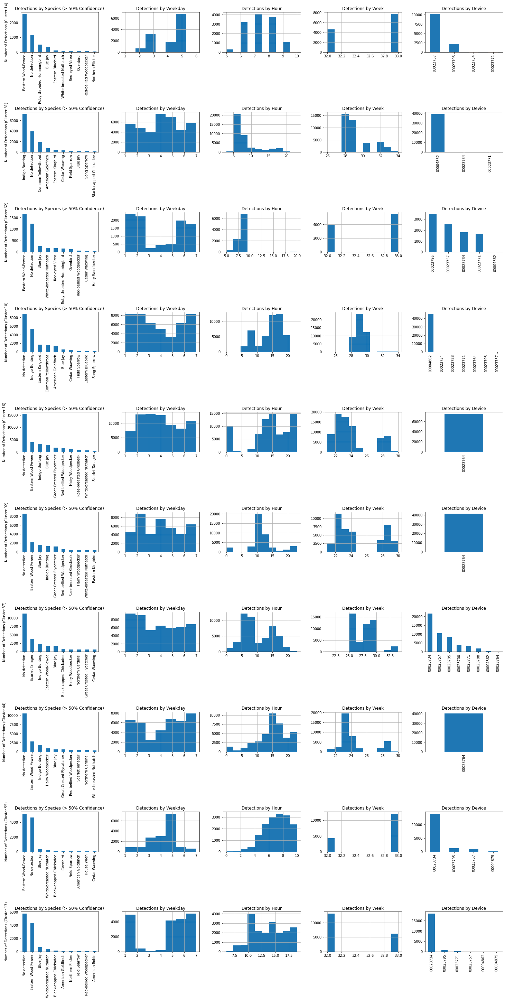

In [18]:
fig, axs = plt.subplots(nrows=len(clusters_data), ncols=5, figsize=(25, 5 * len(clusters_data)))
fig.patch.set_facecolor('white')

for i, (cluster, data) in enumerate(clusters_data.items()):
    ax_row = axs[i]
    
    data[data['confidence'] > 0.5].detection.value_counts()[0:10].plot.bar(ax=ax_row[0])
    ax_row[0].set_title("Detections by Species (> 50% Confidence)")

    data.hist(column='weekday', bins=7, ax=ax_row[1])
    ax_row[1].set_title("Detections by Weekday")

    data.hist(column='hour', ax=ax_row[2])
    ax_row[2].set_title("Detections by Hour")

    data.hist(column='week', ax=ax_row[3])
    ax_row[3].set_title("Detections by Week")

    data.device.value_counts().plot.bar(ax=ax_row[4])
    ax_row[4].set_title("Detections by Device")
    
    ax_row[0].set_ylabel(f"Number of Detections (Cluster {cluster})")

plt.subplots_adjust(hspace=1.5)
plt.show()

### Misc. Plotting

array([[<AxesSubplot:title={'center':'confidence'}>]], dtype=object)

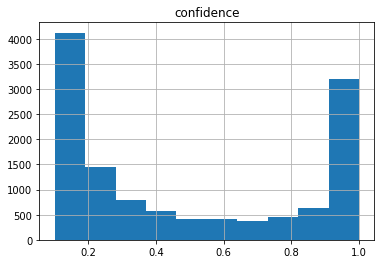

In [74]:
data.hist(column='confidence', bins=10)

array([[<AxesSubplot:title={'center':'confidence'}>]], dtype=object)

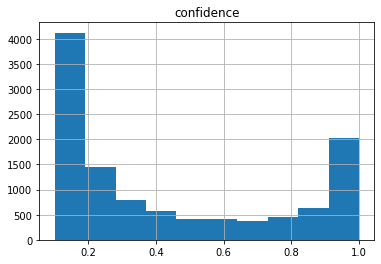

In [75]:
data[data['confidence'] < 1.0].hist(column='confidence', bins=10)

In [47]:
np.sum(data.detection.value_counts()[1:])/data.detection.value_counts()[0]

3.7748110831234256

In [48]:
np.sum(data.detection.value_counts()[1:])

7493

In [49]:
data.detection.value_counts()[0]

1985

In [50]:
data.detection.value_counts()[0]/data.detection.value_counts()[0:].sum()

0.20943236969824858